# Introduction :
- The aim of our project is trying to solve three problems with the given Boston Airbnb dataset from two aspects, the hosts and the travellers. The problems are listed out below:
    - Help the host to decide the price based on the features of their listings provided
    - Help the travellers to choose the listings based on the non-null text features in listings dataset
    - Help the travellers to choose the listings based on the location and also the overall review scores
- We will try some regressors to solve the first problem and find the best regressor while k-mean algorithm to solve the second and the third.
- So basically, the first problem needs to solve with supervised learning model while the second and third can be solved using unsupervised learning

# Problem : Help the host to decide the price based on the features of the listing
- We hope to help the host to decide the price based on the features of their listings provided
- Task : Decide the price based on the features of the listing
- Performance : rmse between predicted values and true values
- Experience : A merged dataset after preprocessing listings.csv, reviews.csv, calendar.csv

# Import all the libraries needed


In [74]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from sklearn import preprocessing
from scipy.stats import pearsonr
from langdetect import detect
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/abhijitverma/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


## Read the data and show some samples
- Convert price column in listing and calendar to numerical and remove the outliers

In [75]:
calendar = pd.read_csv('./calendar.csv')
listings = pd.read_csv('./listings.csv')
reviews = pd.read_csv("./reviews.csv")

# Apply the transformations to the 'price' column in both listings and calendar DataFrames
listings["price"] = listings["price"].map(lambda x: x.replace("$",'').replace(",",''), na_action = 'ignore')
listings["price"] = listings["price"].astype(float)
calendar['price'] = calendar['price'].replace('[\$,]', '', regex=True).astype(float)

# Check the shapes of the three DataFrames
listings.shape, reviews.shape, calendar.shape

((3585, 95), (68275, 6), (1308890, 4))

In [76]:
calendar.head()

,listing_id,date,available,price
0,12147973,2017-09-05,f,NaN
1,12147973,2017-09-04,f,NaN
2,12147973,2017-09-03,f,NaN
3,12147973,2017-09-02,f,NaN
4,12147973,2017-09-01,f,NaN


In [77]:
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,1178162,4724140,2013-05-21,4298113,Olivier,My stay at islam's place was really cool! Good...
1,1178162,4869189,2013-05-29,6452964,Charlotte,Great location for both airport and city - gre...
2,1178162,5003196,2013-06-06,6449554,Sebastian,We really enjoyed our stay at Islams house. Fr...
3,1178162,5150351,2013-06-15,2215611,Marine,The room was nice and clean and so were the co...
4,1178162,5171140,2013-06-16,6848427,Andrew,Great location. Just 5 mins walk from the Airp...


In [78]:
listings.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,12147973,https://www.airbnb.com/rooms/12147973,20160906204935,2016-09-07,Sunny Bungalow in the City,"Cozy, sunny, family home. Master bedroom high...",The house has an open and cozy feel at the sam...,"Cozy, sunny, family home. Master bedroom high...",none,"Roslindale is quiet, convenient and friendly. ...",...,NaN,f,NaN,NaN,f,moderate,f,f,1,NaN
1,3075044,https://www.airbnb.com/rooms/3075044,20160906204935,2016-09-07,Charming room in pet friendly apt,Charming and quiet room in a second floor 1910...,Small but cozy and quite room with a full size...,Charming and quiet room in a second floor 1910...,none,"The room is in Roslindale, a diverse and prima...",...,9.0,f,NaN,NaN,t,moderate,f,f,1,1.30
2,6976,https://www.airbnb.com/rooms/6976,20160906204935,2016-09-07,Mexican Folk Art Haven in Boston,"Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...",none,The LOCATION: Roslindale is a safe and diverse...,...,10.0,f,NaN,NaN,f,moderate,t,f,1,0.47
3,1436513,https://www.airbnb.com/rooms/1436513,20160906204935,2016-09-07,Spacious Sunny Bedroom Suite in Historic Home,Come experience the comforts of home away from...,Most places you find in Boston are small howev...,Come experience the comforts of home away from...,none,Roslindale is a lovely little neighborhood loc...,...,10.0,f,NaN,NaN,f,moderate,f,f,1,1.00
4,7651065,https://www.airbnb.com/rooms/7651065,20160906204935,2016-09-07,Come Home to Boston,"My comfy, clean and relaxing home is one block...","Clean, attractive, private room, one block fro...","My comfy, clean and relaxing home is one block...",none,"I love the proximity to downtown, the neighbor...",...,10.0,f,NaN,NaN,f,flexible,f,f,1,2.25


In [79]:
# Calculate the first and third quartiles (Q1, Q3) and the Interquartile Range (IQR) for the price in listings
Q1 = listings["price"].quantile(0.25)
Q3 = listings["price"].quantile(0.75)
IQR = Q3 - Q1

# Identify outlier IDs
outlier_id = (listings[(listings["price"] < (Q1 - 1.5 * IQR)) |(listings["price"] > (Q3 + 1.5 * IQR))])["id"].to_list()

# Filter out the outliers from the listings DataFrame
listings = listings[~((listings["price"] < (Q1 - 1.5 * IQR)) |(listings["price"] > (Q3 + 1.5 * IQR)))]
listings.shape

(3461, 95)

In [80]:
# Remove rows from reviews and calendar DataFrames corresponding to the outlier listings
for idx in outlier_id:
    reviews = reviews[reviews.listing_id != idx]
    calendar = calendar[calendar.listing_id != idx]   
reviews.shape, calendar.shape

((66927, 6), (1263630, 4))

In [81]:
# Calculate the first and third quartiles (Q1, Q3) and the Interquartile Range (IQR) for the price in calendar
Q1 = calendar["price"].quantile(0.25)
Q3 = calendar["price"].quantile(0.75)
IQR = Q3 - Q1

# Identify outlier IDs in the calendar DataFrame
outlier_id = (calendar[(calendar["price"] < (Q1 - 1.5 * IQR)) |(calendar["price"] > (Q3 + 1.5 * IQR))])["listing_id"].to_list()
# print(outlier_id)

# Filter out the outliers from the calendar DataFrame
calendar = calendar[~((calendar["price"] < (Q1 - 1.5 * IQR)) |(calendar["price"] > (Q3 + 1.5 * IQR)))]
calendar.shape

(1249682, 4)

# Preprocessing of reviews.csv
- In this section, we will drop the empty and meaningless comments followed by language identification for each comment
- We left only the English comments since the majority of comments are English and this also help us to reduce the complexity especially the comments in Chinese
- After that, we perform sentiment analysis for all the comments left and get the new features : "compound", "positivity", "negativity", "neutrality" which will be used in price prediction
- Finally, we group the comments based on listing id and find the mean of each polarity scores

In [82]:
# Count the number of comments for each listing and sort them in descending order
comments = reviews[["listing_id", "comments"]]
comments.groupby("listing_id").count().sort_values("comments", ascending=False)

,comments
listing_id,
66288,402
1497879,320
414419,312
31796,290
815639,281
...,...
13163259,1
7592616,1
7645862,1


## Drop the row with empty string and also meaningless comments
- Some comments are empty strings while some are just meaningless such as ".", "&&", so we drop those comments

In [83]:
# Drop rows with empty strings and predefined meaningless comments
comments = comments[comments.comments.notna()]
meaningless = [
    4361, 18136, 18457, 20327, 23992, 28737, 39504, 41402, 
    42686, 43643, 44592, 53055, 57343, 60731, 61431, 64654
]
comments.drop(meaningless, inplace=True)
comments.shape

(66858, 2)

# Identify the language of comments

In [85]:
lang = []

# Reset the index of the comments DataFrame for proper iteration
comments = comments.reset_index(drop=True)

# Detect the language for each comment
for c in range(len(comments)):
    lang.append(detect(comments.iloc[c, 1]))

In [86]:
# Create a DataFrame from the lang list
lang = pd.DataFrame(lang, columns=["language"])

# Combine the comments DataFrame with the lang DataFrame
combined = pd.concat([comments, lang], ignore_index=True, axis=1)
combined.columns = ["listing_id", "comment", "language"]

# Group by language and count the number of comments
combined.groupby("language").count().sort_values(by="comment", ascending=False)

,listing_id,comment
language,,
en,63216,63216
fr,1343,1343
es,619,619
de,531,531
zh-cn,317,317
it,195,195
ko,112,112
pt,104,104
nl,67,67


- Since the majority comments are in English, we drop the comments in other language to reduce complexity especially Chinese

In [87]:
combined = combined[combined.language == "en"]

# Dropping the 'language' column as it was not properly created
combined.drop('language', axis=1, inplace=True)

# Group by listing_id and count the number of comments, then sort in descending order
combined.groupby("listing_id").count().sort_values("comment", ascending=False)

,comment
listing_id,
66288,380
1497879,310
414419,298
815639,273
916123,272
...,...
12653367,1
9180965,1
6373729,1


## Perform sentiment analysis

In [88]:
# Initialize the SentimentIntensityAnalyzer
sid = SentimentIntensityAnalyzer()

# Apply sentiment analysis to each comment in the 'combined' DataFrame
polarity_scores = [sid.polarity_scores(comment) for comment in combined["comment"]]

## Plot the frequency against polarity scores

<AxesSubplot:ylabel='Frequency'>

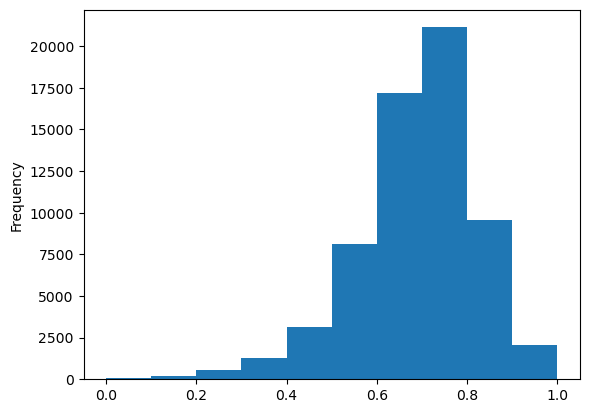

In [89]:
pd.Series([score['neu'] for score in polarity_scores]).plot(kind='hist')

From the histogram, we can infer that a large number of comments have high neutrality scores, clustering around 0.8 to 1.0, which suggests that many comments are classified as neutral by the sentiment analysis tool. There are fewer comments with lower neutrality scores, indicating fewer expressions of strong positive or negative sentiments.

<AxesSubplot:ylabel='Frequency'>

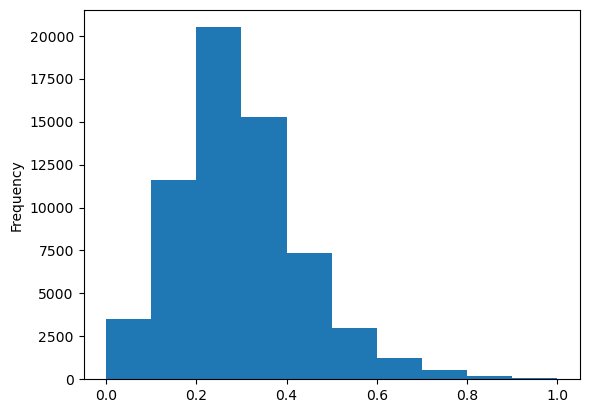

In [90]:
pd.Series([score['pos'] for score in polarity_scores]).plot(kind='hist')

This plot indicates that most comments have low positivity scores, with a large number of comments concentrated close to 0. This could suggest that most comments do not express a strong positive sentiment. There is a long tail towards the higher positivity scores, but these occur much less frequently.

<AxesSubplot:ylabel='Frequency'>

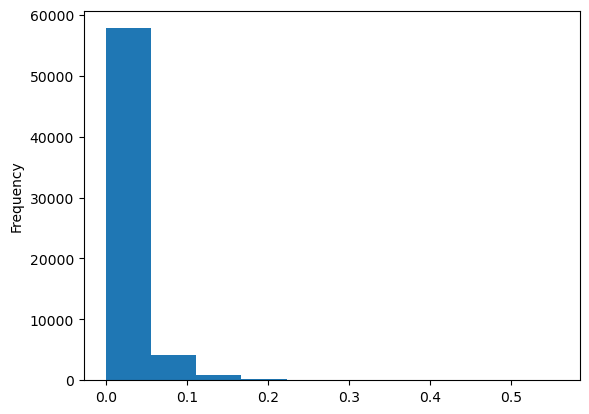

In [91]:
pd.Series([score['neg'] for score in polarity_scores]).plot(kind='hist')

The plot shows that the overwhelming majority of comments have very low negativity scores, clustering near 0. This indicates that most comments are not negative, which could suggest a generally positive or neutral sentiment in the dataset. There are very few comments with higher negativity scores, implying that explicit negative sentiments are not common in these comments.

In [92]:
combined['compound'] = [score['compound'] for score in polarity_scores]
combined['negativity'] = [score['neg'] for score in polarity_scores]
combined['neutrality'] = [score['neu'] for score in polarity_scores]
combined['positivity'] = [score['pos'] for score in polarity_scores]
combined

,listing_id,comment,compound,negativity,neutrality,positivity
0,1178162,My stay at islam's place was really cool! Good...,0.9626,0.000,0.648,0.352
1,1178162,Great location for both airport and city - gre...,0.9061,0.000,0.639,0.361
2,1178162,We really enjoyed our stay at Islams house. Fr...,0.9663,0.000,0.767,0.233
3,1178162,The room was nice and clean and so were the co...,0.9267,0.000,0.673,0.327
4,1178162,Great location. Just 5 mins walk from the Airp...,0.8658,0.000,0.637,0.363
...,...,...,...,...,...,...
66852,7462268,Wonderful location. Bus stop right at the corn...,0.8955,0.049,0.664,0.288
66854,7462268,Joe was on his way to Jamaica to be married! o...,0.9504,0.014,0.822,0.164
66855,7462268,The room was very clean as were the bathrooms ...,0.9693,0.000,0.784,0.216
66856,7462268,Staying in Lower Allston at Joe and Nancy's pl...,0.9957,0.014,0.759,0.226


## Group the comments based on listing id and find the mean of each polarity scores

In [93]:
mean_comments_score = combined.groupby("listing_id").mean().sort_values("compound", ascending=False)
mean_comments_score

,compound,negativity,neutrality,positivity
listing_id,,,,
12603280,0.99360,0.038,0.759,0.202
5584915,0.99285,0.004,0.704,0.292
12699603,0.99280,0.020,0.784,0.195
13655073,0.99210,0.000,0.556,0.444
5719606,0.99170,0.013,0.751,0.236
...,...,...,...,...
13218729,-0.57440,0.086,0.871,0.042
11987762,-0.59280,0.114,0.837,0.049
7245413,-0.78090,0.432,0.568,0.000


The listings are sorted by the average compound score in descending order. The first few listings, such as with ID 12603280, show very high compound scores, which suggests overwhelmingly positive sentiment in the comments. On the other hand, the last few listings, like ID 13236936, have negative compound scores, indicating that the comments have a more negative sentiment on average.

# Preprocessing of listing.csv
- In this section, we first get the names, data type and null values count of columns in it
- After that, we drop the columns with greater than 50% of missing values and also with unique value. At the same time, we drop the row without price.
- Then, we convert some columns with string into boolean and numerical.
- We drop all the irrelevant columns based on our experiences and plot the correlation heat map between every columns and visualize some remaining columns against price.
- Finally we perform one-hot-encoding on some of columns such as "neighbourhood_cleansed", "property_type" etc.

## Get the names and data type of columns in the listings

In [94]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3461 entries, 0 to 3584
Data columns (total 95 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                3461 non-null   int64  
 1   listing_url                       3461 non-null   object 
 2   scrape_id                         3461 non-null   int64  
 3   last_scraped                      3461 non-null   object 
 4   name                              3461 non-null   object 
 5   summary                           3324 non-null   object 
 6   space                             2435 non-null   object 
 7   description                       3461 non-null   object 
 8   experiences_offered               3461 non-null   object 
 9   neighborhood_overview             2094 non-null   object 
 10  notes                             1558 non-null   object 
 11  transit                           2214 non-null   object 
 12  access

## Drop the columns which have more than 50% of missing values

In [95]:
# Identify the columns with more than 50% null values
nulls = listings.columns[listings.isnull().mean() > 0.5]

# Drop these columns from the listings DataFrame
listings.drop(nulls, axis=1, inplace=True)

## Drop the columns with unique value

In [96]:
# Identify the columns with only one unique value
one_value_columns = [column for column in listings.columns if len(listings[column].unique()) == 1]
listings.drop(one_value_columns, axis=1, inplace=True)

## Drop the samples without price 

In [97]:
# Drop rows in the listings DataFrame where 'price' is NaN
listings.dropna(subset=["price"])

,id,listing_url,name,summary,space,description,neighborhood_overview,transit,access,interaction,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,12147973,https://www.airbnb.com/rooms/12147973,Sunny Bungalow in the City,"Cozy, sunny, family home. Master bedroom high...",The house has an open and cozy feel at the sam...,"Cozy, sunny, family home. Master bedroom high...","Roslindale is quiet, convenient and friendly. ...","The bus stop is 2 blocks away, and frequent. B...","You will have access to 2 bedrooms, a living r...",NaN,...,NaN,NaN,NaN,NaN,f,moderate,f,f,1,NaN
1,3075044,https://www.airbnb.com/rooms/3075044,Charming room in pet friendly apt,Charming and quiet room in a second floor 1910...,Small but cozy and quite room with a full size...,Charming and quiet room in a second floor 1910...,"The room is in Roslindale, a diverse and prima...",Plenty of safe street parking. Bus stops a few...,Apt has one more bedroom (which I use) and lar...,"If I am at home, I am likely working in my hom...",...,10.0,10.0,9.0,9.0,t,moderate,f,f,1,1.30
2,6976,https://www.airbnb.com/rooms/6976,Mexican Folk Art Haven in Boston,"Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...",The LOCATION: Roslindale is a safe and diverse...,"PUBLIC TRANSPORTATION: From the house, quick p...","I am living in the apartment during your stay,...","ABOUT ME: I'm a laid-back, friendly, unmarried...",...,10.0,10.0,9.0,10.0,f,moderate,t,f,1,0.47
3,1436513,https://www.airbnb.com/rooms/1436513,Spacious Sunny Bedroom Suite in Historic Home,Come experience the comforts of home away from...,Most places you find in Boston are small howev...,Come experience the comforts of home away from...,Roslindale is a lovely little neighborhood loc...,There are buses that stop right in front of th...,The basement has a washer dryer and gym area. ...,We do live in the house therefore might be som...,...,10.0,10.0,10.0,10.0,f,moderate,f,f,1,1.00
4,7651065,https://www.airbnb.com/rooms/7651065,Come Home to Boston,"My comfy, clean and relaxing home is one block...","Clean, attractive, private room, one block fro...","My comfy, clean and relaxing home is one block...","I love the proximity to downtown, the neighbor...",From Logan Airport and South Station you have...,You will have access to the front and side por...,I love my city and really enjoy sharing it wit...,...,10.0,10.0,9.0,10.0,f,flexible,f,f,1,2.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3580,8373729,https://www.airbnb.com/rooms/8373729,Big cozy room near T,5 min walking to Orange Line subway with 2 sto...,NaN,5 min walking to Orange Line subway with 2 sto...,NaN,NaN,NaN,NaN,...,10.0,10.0,8.0,9.0,t,strict,f,f,8,0.34
3581,14844274,https://www.airbnb.com/rooms/14844274,BU Apartment DexterPark Bright room,"Most popular apartment in BU, best located in ...",Best location in BU,"Most popular apartment in BU, best located in ...",NaN,"There is green line, BU shuttle in front of th...",NaN,NaN,...,NaN,NaN,NaN,NaN,f,strict,f,f,2,NaN
3582,14585486,https://www.airbnb.com/rooms/14585486,Gorgeous funky apartment,Funky little apartment close to public transpo...,Modern and relaxed space with many facilities ...,Funky little apartment close to public transpo...,"Cambridge is a short walk into Boston, and set...","Public transport is 5 minuts away, but walking...",The whole place including social areas is your...,NaN,...,NaN,NaN,NaN,NaN,f,flexible,f,f,1,NaN
3583,14603878,https://www.airbnb.com/rooms/14603878,Great Location; Train and Restaurants,"My place is close to Taco Loco Mexican Grill, ...",NaN,"My place is close to Taco Loco Mexican Grill, ...",NaN,NaN,NaN,NaN,...,9.0,9.0,8.0,7.0,f,strict,f,f,1,

## Convert some columns into numerical or boolean


In [98]:
# Convert columns with 2 unique values to boolean
for c in listings.columns:
  if len(pd.unique(listings[c])) == 2:
    listings[c] = (listings[c] == "t")

In [99]:
# Convert price-related columns from string to float
price_cols_index = listings.columns[listings.columns.str
                                    .contains('cleaning_fee|extra_people') == True]
for variable in price_cols_index:
    listings[variable] = listings[variable].map(lambda x: x.replace("$",'').replace(",",''),
                                                na_action = 'ignore')
    listings[variable] = listings[variable].astype(float)

# Convert rate-related columns from string to float and remove the '%' sign
rate_cols_index = listings.columns[listings.columns.str.contains('rate') == True]
for variable in rate_cols_index:
    listings[variable] = listings[variable].map(lambda x: x.replace("%",''),
                                                na_action = 'ignore')
    listings[variable] = listings[variable].astype(float)

# Count the number of amenities and create a new column
listings['amenities_count'] = listings.amenities.str.count(',')+1

# Drop the original 'amenities' column
listings.drop('amenities', axis=1, inplace=True)

- Drop all the irrelevant columns
- Plot the relationship between price and some of the remaining columns

In [100]:
# Drop columns containing 'url' in their names
url_columns = listings.columns[listings.columns.str.contains('url') == True]
listings.drop(url_columns, axis=1, inplace=True)

# Filter out listings with no reviews
listings = listings[listings.number_of_reviews!=0]

# List of additional columns to be dropped
cols = ["name", 'host_id', 'latitude', 'longitude', 'calculated_host_listings_count', "host_total_listings_count", 
        "street", "zipcode", "market", "smart_location", "neighbourhood", "host_name", "host_neighbourhood",
        "host_about", "host_location", "is_location_exact", "city", 
        "summary", "space", "description", "neighborhood_overview", "transit", "access", "interaction", 
        "house_rules", "availability_30", "availability_60", "availability_90", "availability_365",
        'host_since', 'host_response_time', 'host_response_rate', 'host_acceptance_rate', 'host_is_superhost', 'host_listings_count',
        "calendar_updated", "bed_type", "minimum_nights", "maximum_nights", "host_verifications", "cleaning_fee", 'host_has_profile_pic',
        'host_identity_verified', 'instant_bookable', 'require_guest_profile_picture', 'require_guest_phone_verification',
        "first_review", "last_review", "number_of_reviews", "reviews_per_month", "guests_included", "extra_people"
       ]

# Drop the additional columns
listings.drop(cols, axis=1, inplace=True)

<AxesSubplot:>

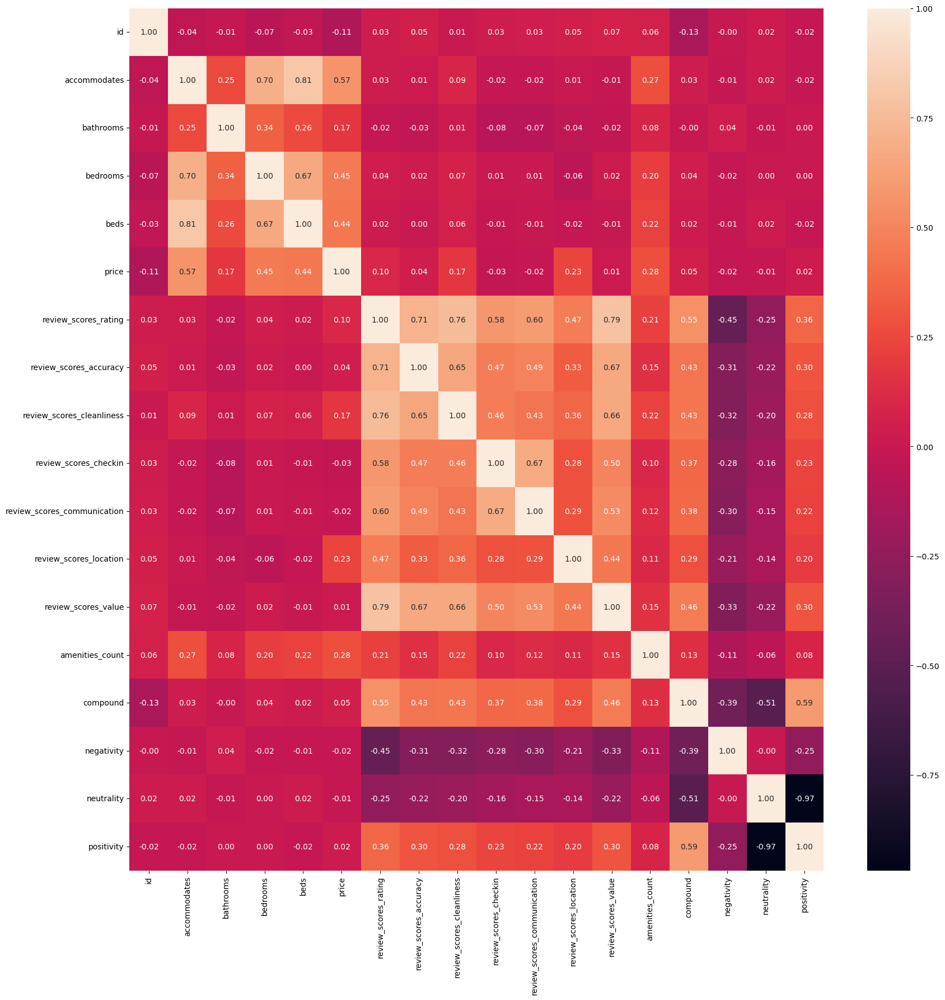

In [101]:
plt.figure(figsize=(20, 20))
sns.heatmap(
    pd.merge(listings, mean_comments_score, how="left", left_on="id", right_on="listing_id").corr(), annot=True,
    fmt=".2f"
)

High Positive Correlations:

- bedrooms and beds have a high correlation of 0.67, which is logical since more bedrooms often mean more beds.
- review_scores_rating has strong positive correlations with review_scores_accuracy (0.71), review_scores_cleanliness (0.76), review_scores_checkin (0.67), review_scores_communication (0.67), review_scores_location (0.33), and review_scores_value (0.66). This suggests that higher ratings in these specific areas are associated with a higher overall rating.
- review_scores_value also correlates well with review_scores_accuracy (0.65), review_scores_cleanliness (0.66), and review_scores_communication (0.53).

Moderate Positive Correlations:

- accommodates is moderately correlated with bedrooms (0.70) and beds (0.81), indicating that properties that can accommodate more people tend to have more bedrooms and beds.
- amenities_count shows moderate correlations with several review scores like review_scores_rating (0.21), review_scores_accuracy (0.22), and review_scores_cleanliness (0.22), suggesting that a higher number of amenities might contribute to better ratings in these areas.

Low to No Correlation:

- The id of the listing shows very low to no correlation with other variables, which is expected since it is likely a unique identifier for each listing with no intrinsic relation to the property's characteristics or reviews.
- price shows very low correlations with most review scores, indicating that the price of the listings doesn't strongly influence how people rate them.

Negative Correlations:

- compound has a strong negative correlation with negativity (-0.93), which might suggest that the compound sentiment score decreases as negative sentiment increases, which is expected behavior for sentiment analysis.
- Interestingly, positivity has a small negative correlation with review_scores_rating (-0.02), which might indicate that more positive reviews are not necessarily associated with higher overall ratings. This could be due to the complexity of how sentiment is expressed in reviews or other factors influencing the overall rating.

Other Observations:

- Sentiment analysis scores (compound, negativity, neutrality, positivity) have various degrees of correlation with each other, with compound having strong negative correlations with negativity and neutrality, and a strong positive correlation with positivity.


/Users/abhijitverma/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


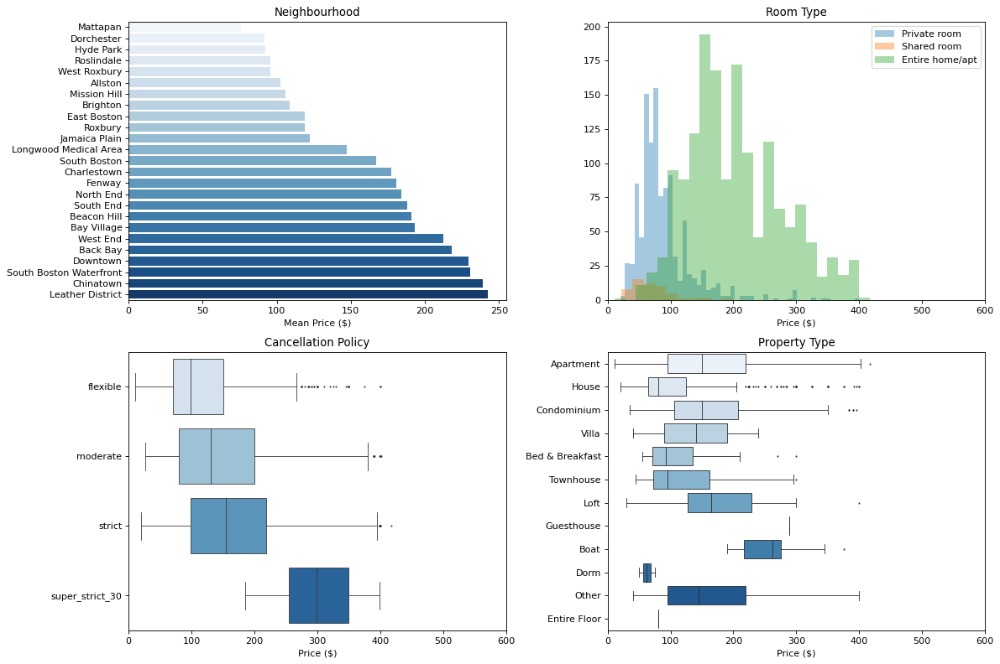

In [30]:
fig, axs = plt.subplots(2, 2, figsize=(15, 10), dpi=80)

# Neighbourhoods
neighbourhoods = listings.groupby('neighbourhood_cleansed').agg(
    {
        'price': np.mean
    }
).reset_index()
sns.barplot(
    x='price', y='neighbourhood_cleansed',
    data=neighbourhoods.sort_values('price'),
    orient='h',
    palette='Blues',
    ax=axs[0, 0]
)
axs[0, 0].set_title('Neighbourhood')
axs[0, 0].set_xlabel('Mean Price ($)')
axs[0, 0].set_ylabel('')

sns.distplot(listings[listings.room_type == 'Private room']['price'],
             kde=False, ax=axs[0, 1], label='Private room')
sns.distplot(listings[listings.room_type == 'Shared room']['price'],
             kde=False, ax=axs[0, 1], label='Shared room')
sns.distplot(listings[listings.room_type == 'Entire home/apt']['price'],
             kde=False, ax=axs[0, 1], label='Entire home/apt')
axs[0, 1].set_xlim(0, 600)
axs[0, 1].set_title('Room Type')
axs[0, 1].set_xlabel('Price ($)')
axs[0, 1].legend()

# Cancellation Policy
sns.boxplot(x='price', y='cancellation_policy', fliersize=1, linewidth=0.75,
            data=listings, palette='Blues', ax=axs[1, 0],
            order=['flexible', 'moderate', 'strict', 'super_strict_30'])
axs[1, 0].set_xlim(0, 600)
axs[1, 0].set_title('Cancellation Policy')
axs[1, 0].set_xlabel('Price ($)')
axs[1, 0].set_ylabel('')

# Property type
sns.boxplot(x='price', y='property_type', fliersize=1, linewidth=0.75,
            data=listings, palette='Blues', ax=axs[1, 1])
axs[1, 1].set_xlim(0, 600)
axs[1, 1].set_title('Property Type')
axs[1, 1].set_xlabel('Price ($)')
axs[1, 1].set_ylabel('')

plt.tight_layout()
plt.show();

Neighbourhood (Top Left):
- This bar plot shows the mean price of listings grouped by neighbourhood.
- The neighbourhoods are sorted by price, ascending from top to bottom. The Leather District appears to have the highest mean price, while Mattapan has the lowest.

Room Type (Top Right):

- This is a distribution plot for the price of different types of rooms: private room, shared room, and entire home/apartment.
- It appears that entire homes/apartments tend to be priced higher than private and shared rooms, with a wide distribution indicating a range of prices.
- Private rooms and shared rooms are more concentrated in the lower price ranges.

Cancellation Policy (Bottom Left):

- This box plot shows the distribution of prices for listings with different cancellation policies: flexible, moderate, strict, and super strict 30.
- The 'super_strict_30' category has the highest median price and also shows some high-priced outliers.
- 'Strict' and 'moderate' have similar price distributions, while 'flexible' tends to have a lower median price.

Property Type (Bottom Right):

- This box plot visualizes the price distribution across different property types.
- The property types are numerous, including apartments, houses, condominiums, villas, bed and breakfasts, townhouses, lofts, guesthouses, boats, dorms, and other categories.
- Some property types, like 'Boat' and 'Entire Floor', show a higher median price, with 'Boat' exhibiting a significant number of high-priced outliers.
- 'Apartment' and 'House' types are more numerous and show a wide range of prices with several outliers.

# Performing one-hot-encoding

In [31]:
neighbourhood = pd.get_dummies(listings["neighbourhood_cleansed"])
listings.drop("neighbourhood_cleansed", axis=1, inplace=True)

property_type = pd.get_dummies(listings["property_type"])
listings.drop("property_type", axis=1, inplace=True)

room_type = pd.get_dummies(listings["room_type"])
listings.drop("room_type", axis=1, inplace=True)

cancellation = pd.get_dummies(listings["cancellation_policy"])
listings.drop("cancellation_policy", axis=1, inplace=True)

listings = pd.concat([listings, neighbourhood, property_type, room_type, cancellation], axis=1)



# Preprocessing calendar.csv
- Convert the available columns to boolean
- Drop the samples without price given
- Find the mean of both available and price columns based on month
- Normalize both columns
- Find that they are highly correlated
- Drop the available column since it is actually covered by the price columns based on the correlation

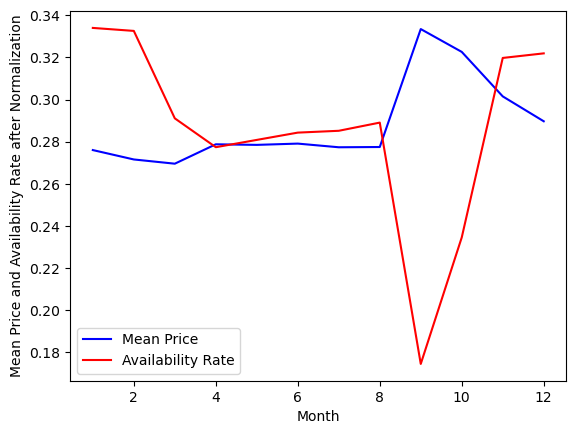

-0.7513731097870744

In [32]:
calendar['available'] = (calendar['available']=='t')
calendar['month'] = pd.DatetimeIndex(calendar['date']).month
ava_rate = calendar.groupby('month')['available'].mean()
ava_rate_norm = preprocessing.normalize([ava_rate])

calendar.dropna(subset=["price"], inplace=True)
mean_price = calendar.groupby('month')['price'].mean()
mean_price_norm = preprocessing.normalize([mean_price])

plt.figure()
month = [x for x in range(1, 13)]
plt.plot(month, mean_price_norm[0, :], "b", label="Mean Price")
plt.plot(month, ava_rate_norm[0, :], "r", label="Availability Rate")
plt.xlabel("Month")
plt.ylabel("Mean Price and Availability Rate after Normalization")
plt.legend()
plt.show()

corr, _ = pearsonr(ava_rate_norm[0, :], mean_price_norm[0, :])
corr

From the graph, we can observe the following:

- The blue line represents the normalized mean price per month. It shows some fluctuations over the months but does not follow a clear trend.
- The red line represents the normalized availability rate per month. There is a noticeable dip around the 8th to 10th months, suggesting a decrease in availability during these months.

The Pearson correlation coefficient between the normalized availability rate and the normalized mean price is approximately -0.751, which suggests a strong negative correlation between the two variables. In other words, when the availability rate decreases, the mean price tends to increase, and vice versa. This is quite common in supply and demand dynamics; as fewer listings are available (implying higher demand or lower supply), the prices tend to go up.

In [33]:
calendar.drop("available", axis=1, inplace=True)

In [34]:
month = pd.get_dummies(calendar["month"])
calendar.drop("date", axis=1, inplace=True)
calendar.drop("month", axis=1, inplace=True)
calendar = pd.concat([calendar, month], axis=1)
calendar.sample(10)

,listing_id,price,1,2,3,4,5,6,7,8,9,10,11,12
742669,3653207,250.0,0,0,0,0,0,0,0,0,0,0,1,0
1071027,400067,56.0,0,0,0,1,0,0,0,0,0,0,0,0
113005,1692573,135.0,1,0,0,0,0,0,0,0,0,0,0,0
803813,25142,349.0,0,0,1,0,0,0,0,0,0,0,0,0
807994,14660851,100.0,0,0,0,0,0,0,0,0,0,0,1,0
1068485,4431210,59.0,0,1,0,0,0,0,0,0,0,0,0,0
208655,14898198,92.0,1,0,0,0,0,0,0,0,0,0,0,0
965756,4556374,60.0,0,0,0,0,0,0,0,0,0,1,0,0
1132050,10850420,190.0,0,0,0,0,0,0,0,0,1,0,0,0
196280,12265433,400.0,0,0,0,0,0,0,1,0,0,0,0,0


# Merge the three prepared datasets

In [35]:
df = pd.merge(
    listings, calendar, how='left',
    left_on='id', right_on='listing_id',
)

df = df.drop(['price_x', 'listing_id' ], axis=1)
df = df.rename({'price_y': 'price'}, axis=1)

# Drop any remaining rows without a price value
df = df.dropna(subset=['price'])
df.rename(columns={1:"Jan", 2:"Feb", 3:"Mar", 4:"Apr", 5:"May", 6:"Jun", 7:"Jul", 8:"Aug", 9:"Sep", 10:"Oct",
                   11:"Nov", 12:"Dec"}, inplace=True)

df = pd.merge(df, mean_comments_score, how="left", left_on="id", right_on="listing_id")
df["compound"].fillna(df["compound"].mean(), inplace=True)
df["negativity"].fillna(df["negativity"].mean(), inplace=True)
df["neutrality"].fillna(df["neutrality"].mean(), inplace=True)
df["positivity"].fillna(df["positivity"].mean(), inplace=True)

In [36]:
df.shape

(496384, 74)

# Define a function to print and return the score of each model
- R Squared
- Root Mean Squared Error

In [37]:
def scores(model, X_train, y_train, X_test, y_test):
    """Print the R-squared and RMSE scores for the train and test set
    
    Parameters
        model: fitted regression model
    """
    
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    r2_train = r2_score(y_train, y_pred_train)
    r2_test = r2_score(y_test, y_pred_test)
    rmse_train = (mean_squared_error(y_train, y_pred_train))**0.5
    rmse_test = (mean_squared_error(y_test, y_pred_test))**0.5

    print(
        'Train R-squared: {:.5f}\tTrain RMSE: ${:.5f}\
        \nTest R-squared: {:.5f}\tTest RMSE: ${:.5f}'
        .format(r2_train, rmse_train, r2_test, rmse_test)
    )
    
    return r2_train, r2_test, rmse_train, rmse_test, y_pred_test

# Final Preparation
- Drop the rows with any null value
- Drop the id column 
- Drop the price column from training data

In [38]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

df.dropna(inplace=True)
df.drop("id", axis=1, inplace=True)

In [39]:
df.columns

Index(['accommodates', 'bathrooms', 'bedrooms', 'beds', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value', 'amenities_count',
       'Allston', 'Back Bay', 'Bay Village', 'Beacon Hill', 'Brighton',
       'Charlestown', 'Chinatown', 'Dorchester', 'Downtown', 'East Boston',
       'Fenway', 'Hyde Park', 'Jamaica Plain', 'Leather District',
       'Longwood Medical Area', 'Mattapan', 'Mission Hill', 'North End',
       'Roslindale', 'Roxbury', 'South Boston', 'South Boston Waterfront',
       'South End', 'West End', 'West Roxbury', 'Apartment', 'Bed & Breakfast',
       'Boat', 'Condominium', 'Dorm', 'Entire Floor', 'Guesthouse', 'House',
       'Loft', 'Other', 'Townhouse', 'Villa', 'Entire home/apt',
       'Private room', 'Shared room', 'flexible', 'moderate', 'strict',
       'super_strict_30', 'price', 'Jan', 'Feb', 'Mar', 'Apr', 

## Testing model with just one feature

In [40]:
X = df.review_scores_value
y = df.price

(479741,)


In [41]:
X

0         9.0
1         9.0
2         9.0
3         9.0
4         9.0
         ... 
496379    7.0
496380    7.0
496381    7.0
496382    7.0
496383    7.0
Name: review_scores_value, Length: 479741, dtype: float64

In [42]:
y

0         65.0
1         65.0
2         65.0
3         75.0
4         75.0
          ... 
496379    59.0
496380    59.0
496381    59.0
496382    59.0
496383    59.0
Name: price, Length: 479741, dtype: float64

In [47]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Split the data into training and testing sets (e.g., 80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X.values.reshape(-1, 1), y, test_size=0.2, random_state=42)

# Create and fit a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)

print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
print(f"R-squared (R2): {r2:.4f}")


Root Mean Squared Error (RMSE): 99.51
R-squared (R2): 0.0008


Root Mean Squared Error (RMSE): The RMSE is approximately $99.51, indicating that, on average, the model's predictions have an error of about $99.51 when compared to the actual prices. Lower RMSE values are preferred, so this value suggests that there is room for improvement in the model's predictive accuracy.

R-squared (R2): The R-squared value is 0.0008, which is very close to zero. This indicates that only a tiny fraction (less than 1%) of the variability in 'price' can be explained by the 'review_scores_value' variable. In other words, the linear regression model does not provide a good fit to the data, as it fails to explain much of the variance in price.

In summary, the linear regression model using 'review_scores_value' as the predictor variable does not perform well in explaining or predicting the 'price' in your dataset. Further analysis or the inclusion of additional features are needed to improve the model's predictive accuracy.

In [48]:
# Therefore using all other features also to train our models

X = df.drop('price', axis=1)
print(X.shape)
y = df.price

(479741, 72)


# Models used:
- Linear model : 
    - Linear regression : Minimize the residual sum of squares between the observed targets in the dataset, and the targets predicted by the linear approximation, the mathematical equation is shown below :
    
    $$\min_{w}||Xw-y||^{2}_{2}$$
    
    - Lasso regression : Linear model that estimates sparse coefficients. It is useful in some contexts due to its tendency to prefer solutions with fewer non-zero coefficients, effectively reducing the number of features upon which the given solution is dependent
    
    $$\min_{w}\frac{1}{2N}||Xw-y||^{2}_{2}+\alpha||w||_{1}$$
    
    - Ridge regression : Addresses some of the problems of Ordinary Least Squares by imposing a penalty on the size of the coefficients, the mathematical equation is shown below :
    
    $$\min_{w}||Xw-y||^{2}_{2} + \alpha||w||^{2}_{2}$$
    
    - Elastic Net regression : Linear regression model trained with both  and -norm regularization of the coefficients. This combination allows for learning a sparse model where few of the weights are non-zero like Lasso, while still maintaining the regularization properties of Ridge.
    
    $$\min_{w}||Xw-y||^{2}_{2} + \alpha\rho||w||_{1} + \alpha\frac{1-\rho}{2}||w||^{2}_{2}$$
    
- Tree model : 
    - Decision tree regressor : A supervised learning method that create a model that predicts the value of a target variable by learning simple decision rules inferred from the data features.
- Ensemble model :
    - Random forest regressor : An ensemble technique capable of performing both regression and classification tasks with the use of multiple decision trees and a technique called Bootstrap and Aggregation, commonly known as bagging.
- KNeighbors model :
    - KNN regressor : Learning based on the nearest neighbors of each query point, where $k$ is an integer value specified by the user.

# Train and Validate

In [49]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from scipy.stats import uniform, truncnorm, randint
from time import time

model_scores = {}
time_used = []
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

## Linear regression
- Randomized Search Cross Validation

Train R-squared: 0.72580	Train RMSE: $52.00458        
Test R-squared: 0.72616	Test RMSE: $52.11917
Time used =  0.5405502319335938


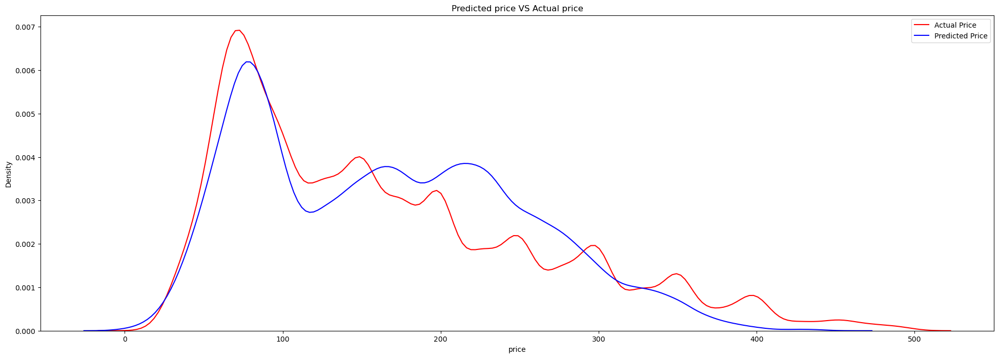

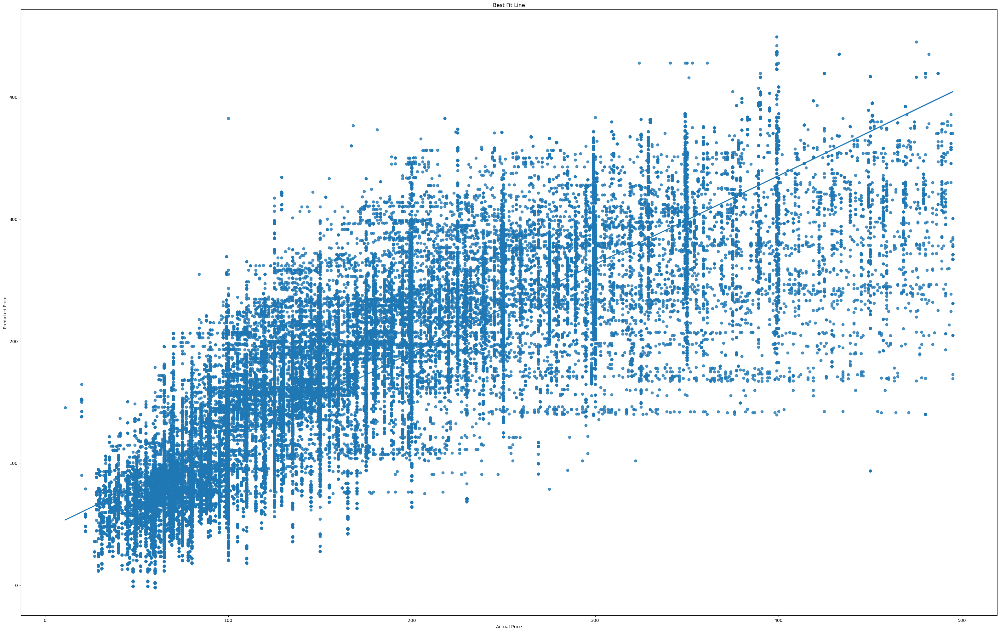

In [50]:
start = time()
linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(linear_reg, X_train, y_train, X_test, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["linear_reg"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end-start)

## Lasso regression
- Randomized Search Cross Validation

0.7121780160965641
{'alpha': 0.25148863200136656}
Train R-squared: 0.71227	Train RMSE: $53.27225        
Test R-squared: 0.71319	Test RMSE: $53.33868
Time used =  23.027891159057617


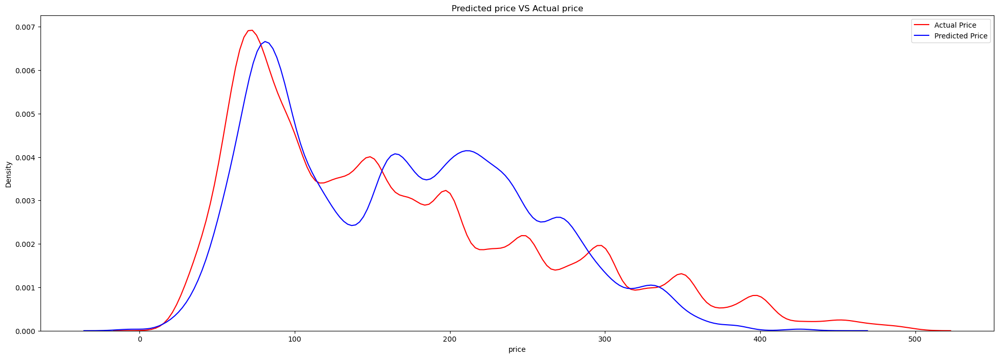

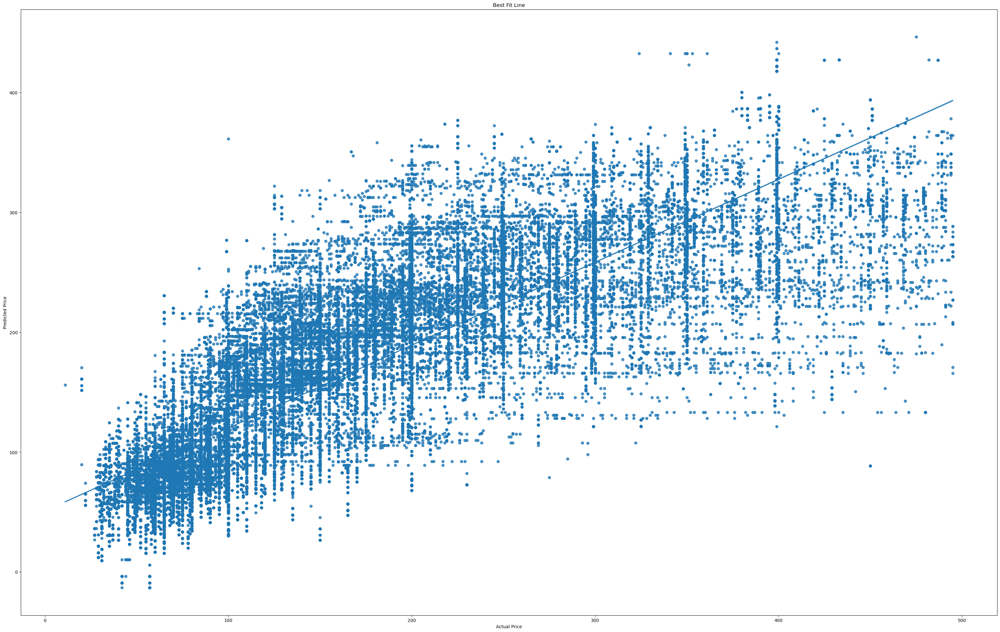

In [51]:
start = time()
lasso_params = {
    "alpha":truncnorm(a=0, b=1000, loc=0.25, scale=0.1),
}
lasso = Lasso()
RandomSearch = RandomizedSearchCV(lasso, lasso_params, n_jobs=-1)
RandomSearch.fit(X_train, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
lasso = Lasso(**RandomSearch.best_params_)
lasso.fit(X_train, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(lasso, X_train, y_train, X_test, y_test)
end = time()
print("Time used = ", end - start)


fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
plt.legend()
ax1.set_title("Predicted price VS Actual price")
plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["lasso"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Ridge regression
- Randomized Search Cross Validation

0.7256670373479136
{'alpha': 0.2689569552662692}
Train R-squared: 0.72580	Train RMSE: $52.00523        
Test R-squared: 0.72616	Test RMSE: $52.11914
Time used =  9.983532905578613


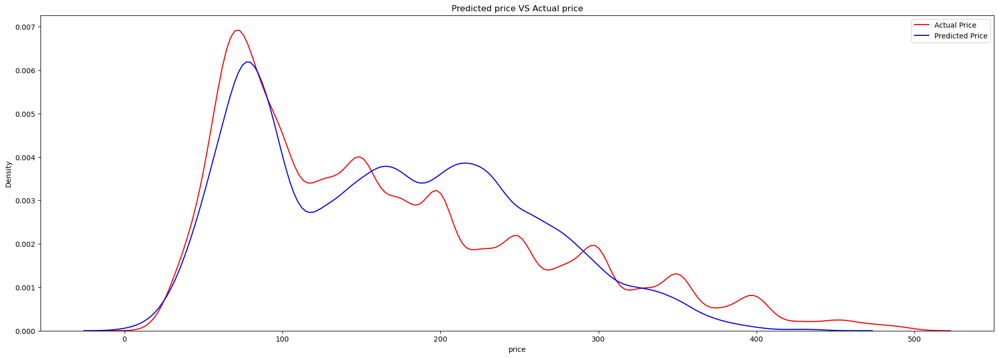

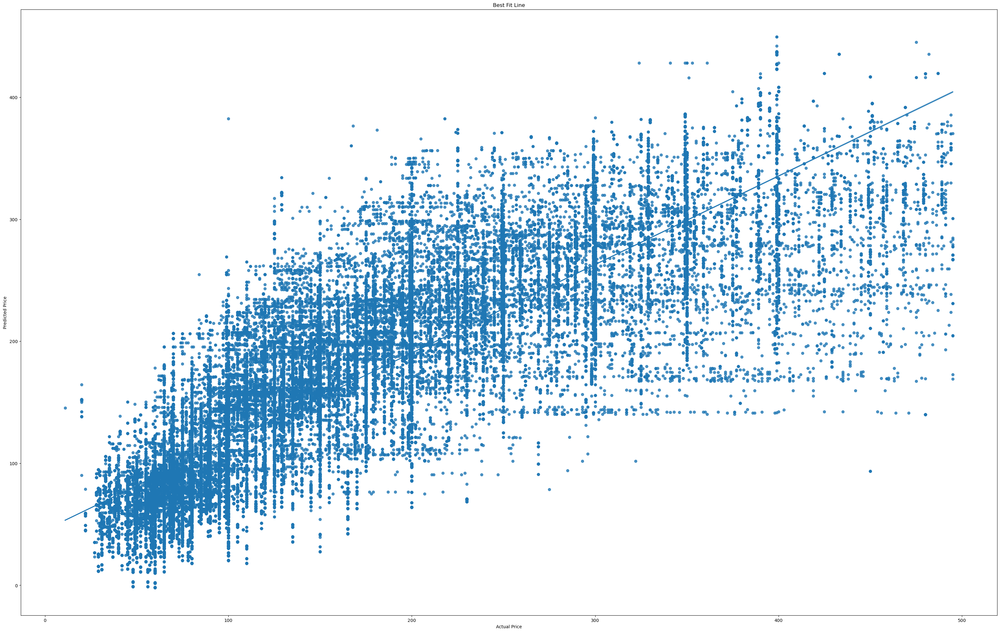

In [52]:
start = time()
ridge_params = {
    "alpha":truncnorm(a=0, b=1000, loc=0.25, scale=0.1),
}
ridge = Ridge()
RandomSearch = RandomizedSearchCV(ridge, ridge_params, n_jobs=-1)
RandomSearch.fit(X_train, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
ridge = Ridge(**RandomSearch.best_params_)
ridge.fit(X_train, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(ridge, X_train, y_train, X_test, y_test)
end = time()
print("Time used = ", end - start)


fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["ridge"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Elastic Net regression
- Randomized Search Cross Validation

0.668766962040371
{'alpha': 0.2649780802374914, 'l1_ratio': 0.7953402192486868}
Train R-squared: 0.66883	Train RMSE: $57.15234        
Test R-squared: 0.66954	Test RMSE: $57.25409
Time used =  17.39847493171692


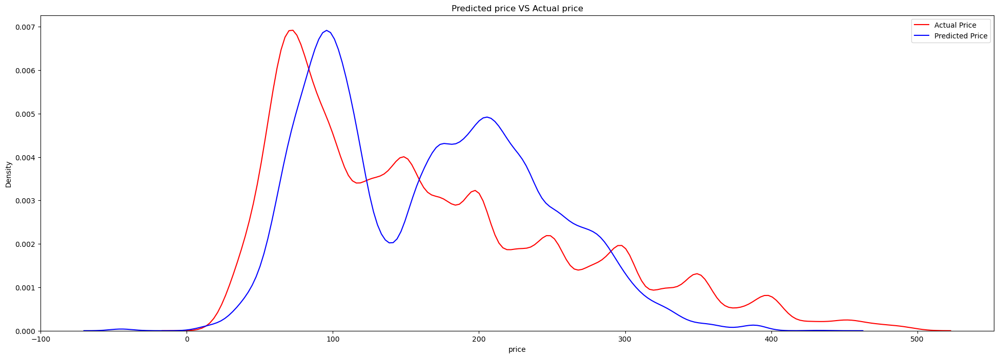

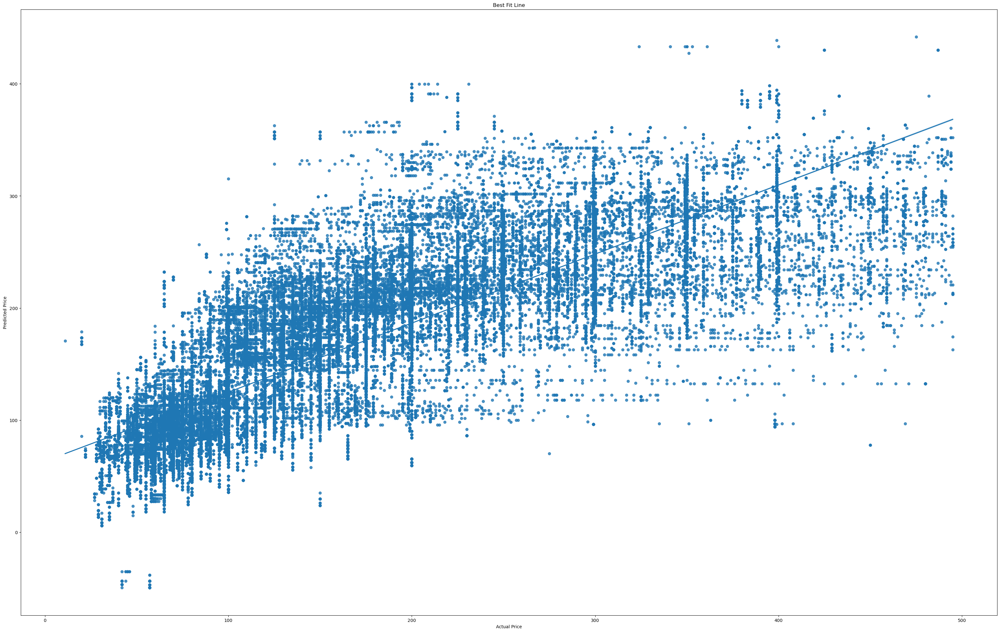

In [53]:
start = time()
EN_params = {
    "alpha":truncnorm(a=0, b=1000, loc=0.25, scale=0.1),
    "l1_ratio":uniform(0, 1)
}
EN = ElasticNet()
RandomSearch = RandomizedSearchCV(EN, EN_params, n_jobs=-1)
RandomSearch.fit(X_train, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
EN = ElasticNet(**RandomSearch.best_params_)
EN.fit(X_train, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(EN, X_train, y_train, X_test, y_test)
end = time()
print("Time used = ", end - start)


fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()
plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["EN"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Decision Tree regressor
- Grid Search Cross Validation
- Randomized Search Cross Validation

0.9735366143709966
{'max_depth': 1000, 'min_samples_split': 10}
Train R-squared: 0.97761	Train RMSE: $14.85914        
Test R-squared: 0.97458	Test RMSE: $15.87877
Time used =  33.771987199783325



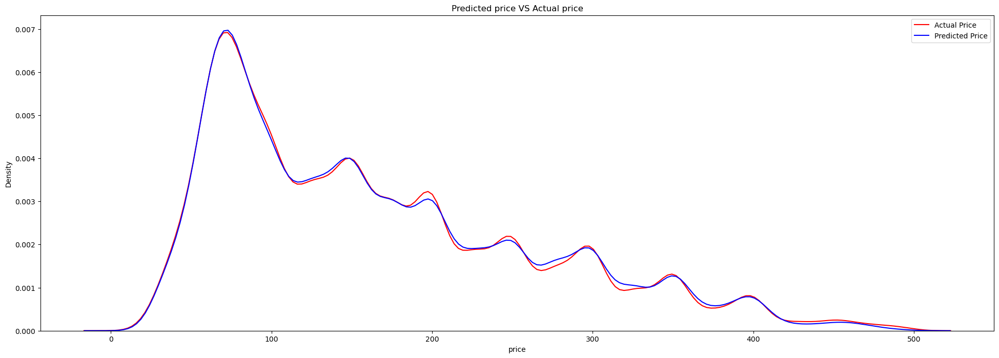

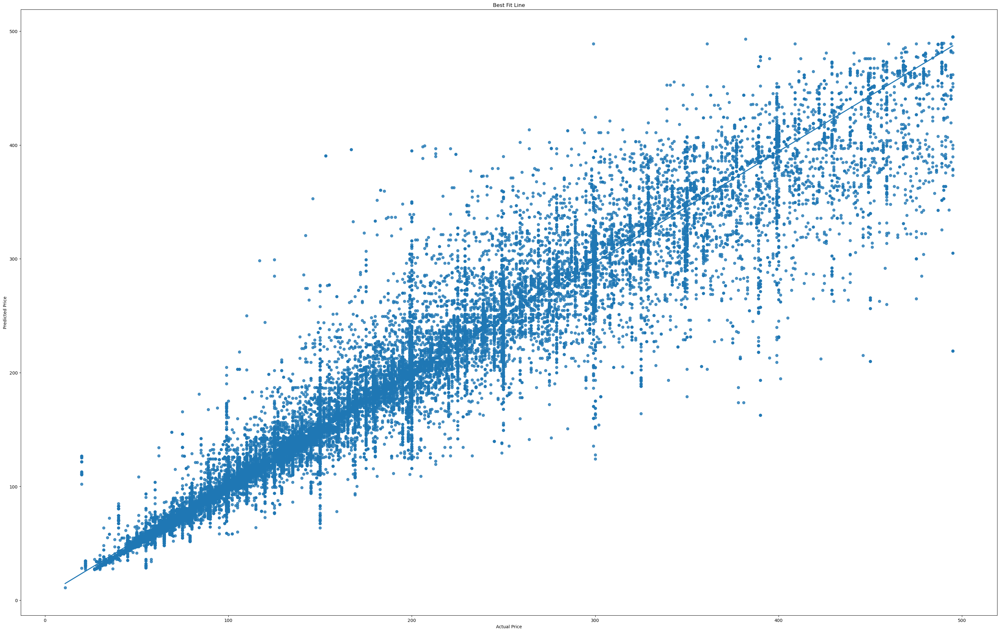

0.9373456363658443
{'max_depth': 795, 'min_samples_split': 189}
Train R-squared: 0.94681	Train RMSE: $22.90561        
Test R-squared: 0.94383	Test RMSE: $23.60403
Time used =  30.778902053833008


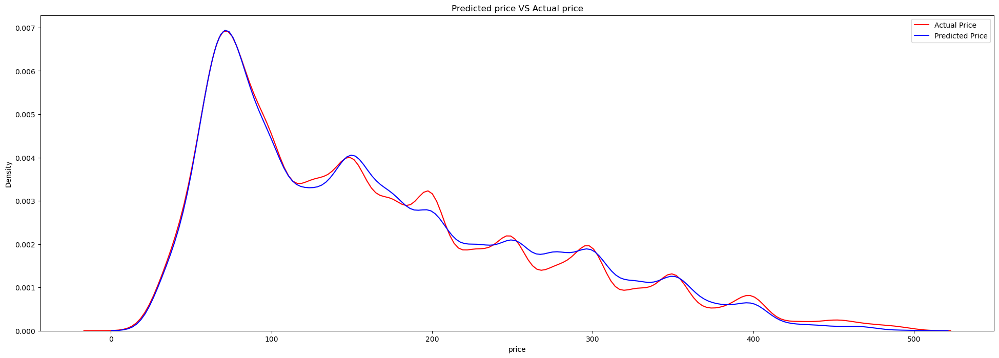

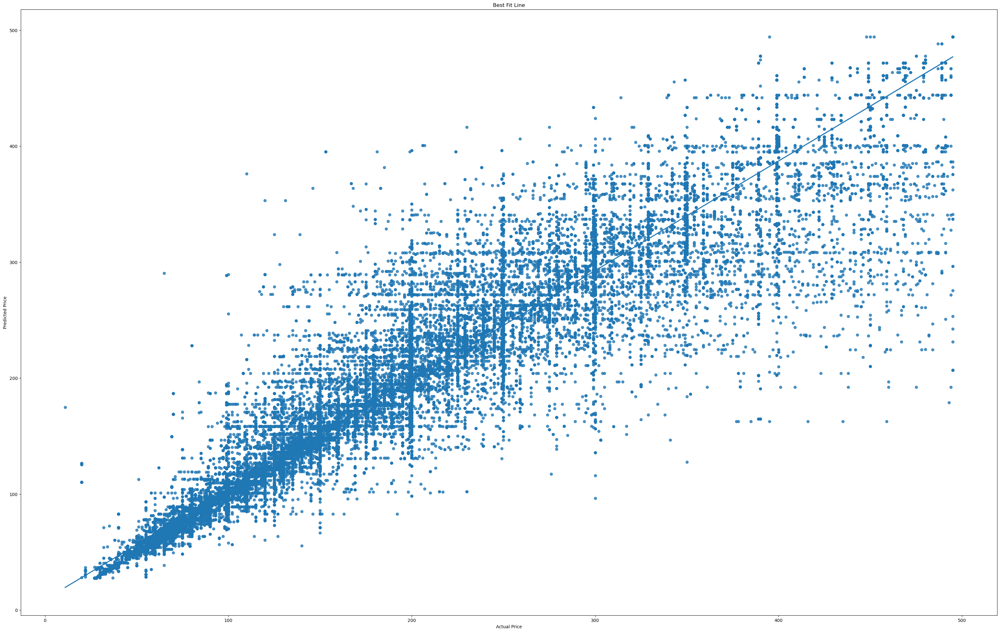

In [54]:
start = time()
tree_params = {
    "max_depth":[10, 100, 1000,], 
    "min_samples_split":[10, 50, 100, 1000]
    }
dtr = DecisionTreeRegressor()
GridSearch = GridSearchCV(dtr, tree_params, n_jobs=-1)
GridSearch.fit(X_train, y_train)
print(GridSearch.best_score_)
print(GridSearch.best_params_)
dtr = DecisionTreeRegressor(**GridSearch.best_params_)
dtr.fit(X_train, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(dtr, X_train, y_train, X_test, y_test)
end = time()
print("Time used = ", end - start)
print()

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["gridsearch_dtr"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

start = time()
tree_params = {
    "max_depth":randint(1, 1000), 
    "min_samples_split":randint(1, 1000)
    }
dtr = DecisionTreeRegressor()
RandomSearch = RandomizedSearchCV(dtr, tree_params, n_jobs=-1)
RandomSearch.fit(X_train, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
dtr = DecisionTreeRegressor(**RandomSearch.best_params_)
dtr.fit(X_train, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(dtr, X_train, y_train, X_test, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["randomsearch_dtr"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Random Forest regressor
- Grid Search Cross Validation
- Randomized Search Cross Validation

0.9738234908715299
{'n_estimators': 50}
Train R-squared: 0.97761	Train RMSE: $14.86046        
Test R-squared: 0.97474	Test RMSE: $15.82950
Time used =  349.64100193977356


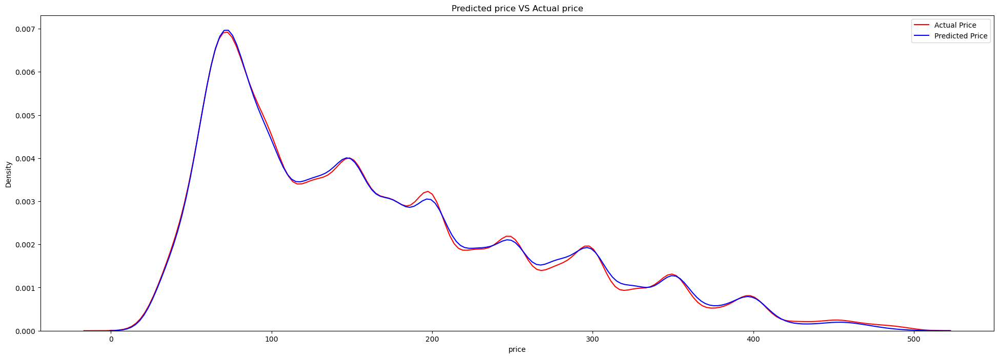

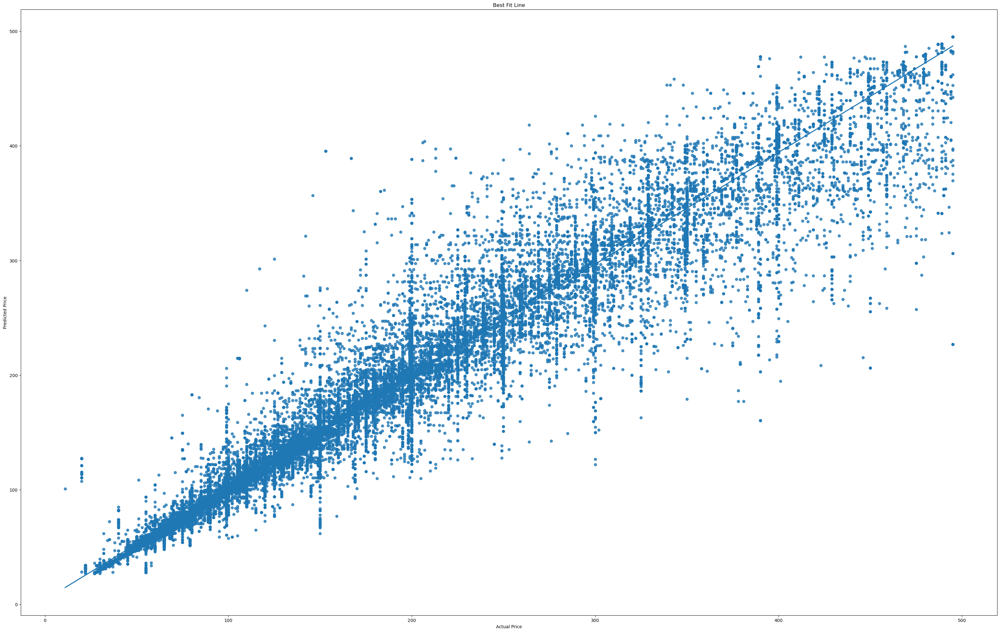

0.9738042034884256
{'n_estimators': 36}
Train R-squared: 0.97761	Train RMSE: $14.86030        
Test R-squared: 0.97470	Test RMSE: $15.84095
Time used =  882.3936240673065


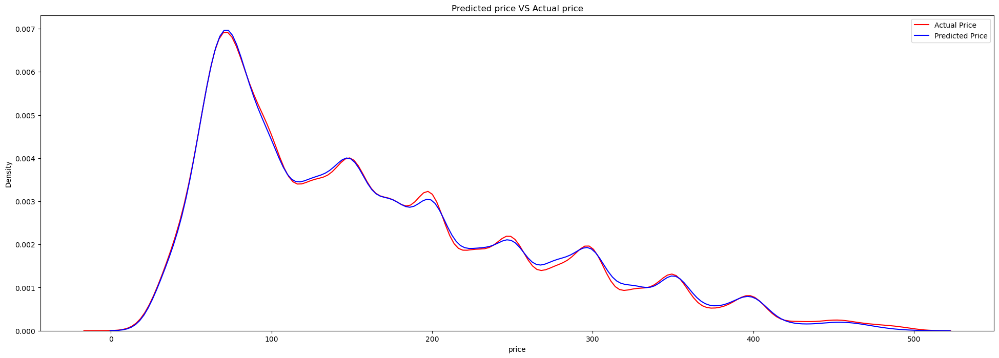

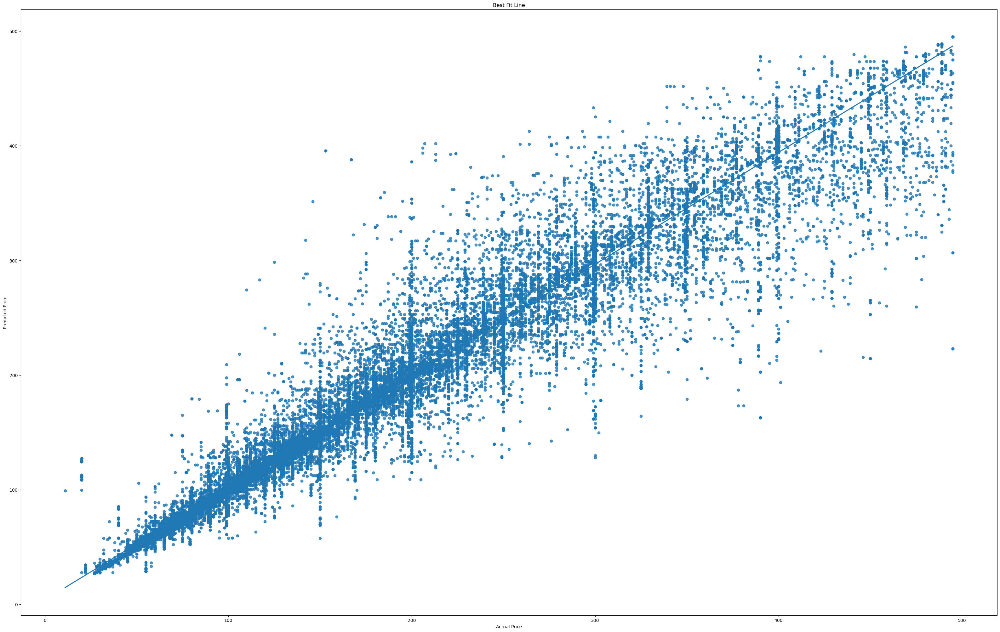

In [55]:
start = time()
forest_params = {
    'n_estimators':[30, 40, 50],
}
rf = RandomForestRegressor()
GridSearch = GridSearchCV(rf, forest_params, n_jobs=-1)
GridSearch.fit(X_train, y_train)
print(GridSearch.best_score_)
print(GridSearch.best_params_)
rf = RandomForestRegressor(**GridSearch.best_params_)
rf.fit(X_train, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(rf, X_train, y_train, X_test, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["gridsearch_rf"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

start = time()
forest_params = {
    'n_estimators':randint(21, 50),
    }
rf = RandomForestRegressor()
RandomSearch = RandomizedSearchCV(rf, forest_params, n_jobs=-1)
RandomSearch.fit(X_train, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
rf = RandomForestRegressor(**RandomSearch.best_params_)
rf.fit(X_train, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(rf, X_train, y_train, X_test, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["randomsearch_rf"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Before we try with more models, we perform PCA to reduce the dimensions of our data or else the computational time such as KNN will be extremely long

In [56]:
from sklearn.decomposition import PCA
pca = PCA(n_components=X_train.shape[1])
pca.fit(X_train)

PCA(n_components=72)

In [57]:
X_pca = pca.transform(X_train)
n_pcs = pca.components_.shape[0]
most_important = [np.abs(pca.components_[i]).argmax() for i in range(n_pcs)]
initial_feature_names = list(X_train.columns)
most_important_names = [initial_feature_names[most_important[i]] for i in range(n_pcs)]
pca_analysis = pd.DataFrame(list(zip(most_important_names, pca.explained_variance_ratio_)))
print(pca_analysis.to_string())

                              0             1
0          review_scores_rating  7.182638e-01
1               amenities_count  1.930393e-01
2                  accommodates  3.231369e-02
3        review_scores_location  7.322635e-03
4     review_scores_cleanliness  5.689467e-03
5   review_scores_communication  4.464545e-03
6        review_scores_location  3.889336e-03
7                        strict  3.125880e-03
8        review_scores_accuracy  2.831610e-03
9           review_scores_value  2.183324e-03
10                     bedrooms  2.070315e-03
11                    bathrooms  1.764054e-03
12                     flexible  1.722182e-03
13                 Private room  1.595905e-03
14  review_scores_communication  1.553957e-03
15                     bedrooms  1.338937e-03
16                Jamaica Plain  8.451880e-04
17                          Jan  8.207860e-04
18                          Dec  7.794921e-04
19                          Feb  7.448547e-04
20                          Mar  7

## Carry out dimension reduction
- Use the top principal components that retain 95% of data

In [58]:
pca_95 = PCA(.95)
pca_95.fit(X_train)
X_pca = pca_95.transform(X_train)
n_pcs= pca_95.components_.shape[0]
most_important = [np.abs(pca_95.components_[i]).argmax() for i in range(n_pcs)]
initial_feature_names = list(X_train.columns)
most_important_names = [initial_feature_names[most_important[i]] for i in range(n_pcs)]
pca_analysis = pd.DataFrame(list(zip(most_important_names, pca.explained_variance_ratio_)))
pca_analysis

,0,1
0,review_scores_rating,0.718264
1,amenities_count,0.193039
2,accommodates,0.032314
3,review_scores_location,0.007323


In [59]:
X_train_reduced = pca_95.transform(X_train)
X_test_reduced = pca_95.transform(X_test)

## Linear regression with reduced data

Train R-squared: 0.50969	Train RMSE: $69.54165        
Test R-squared: 0.51000	Test RMSE: $69.71793
Time used =  0.03408622741699219


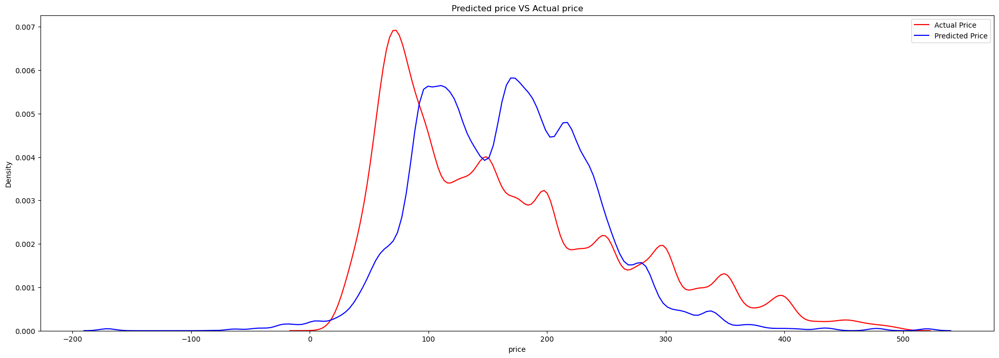

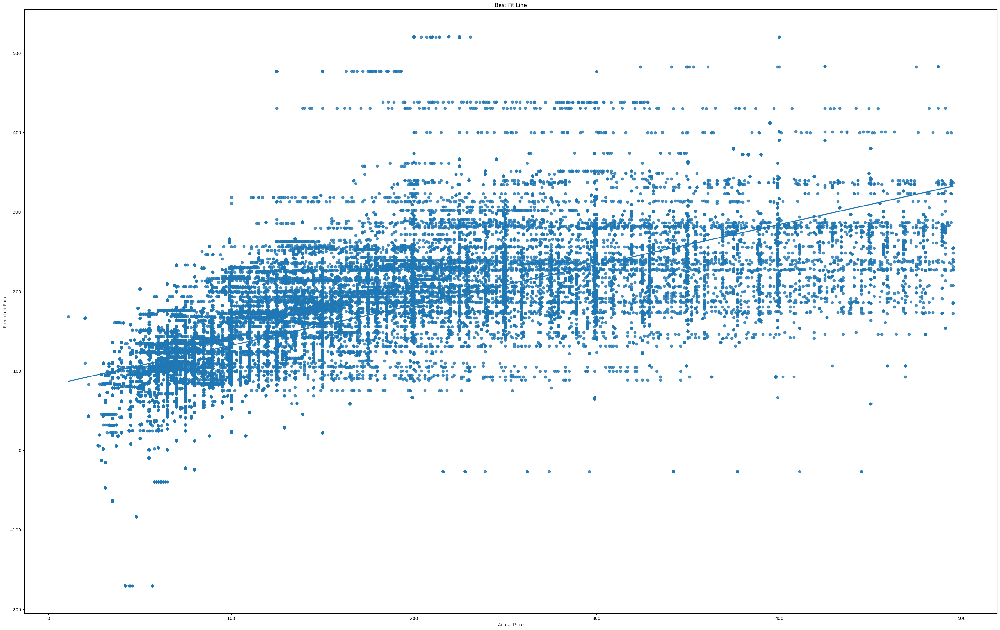

In [60]:
start = time()
linear_reg = LinearRegression()
linear_reg.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(linear_reg, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["pca_linear_reg"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end-start)

## Lasso regression with reduced data

0.5096605974356103
{'alpha': 0.2523824452164829}
Train R-squared: 0.50968	Train RMSE: $69.54232        
Test R-squared: 0.50997	Test RMSE: $69.72008
Time used =  0.7467167377471924


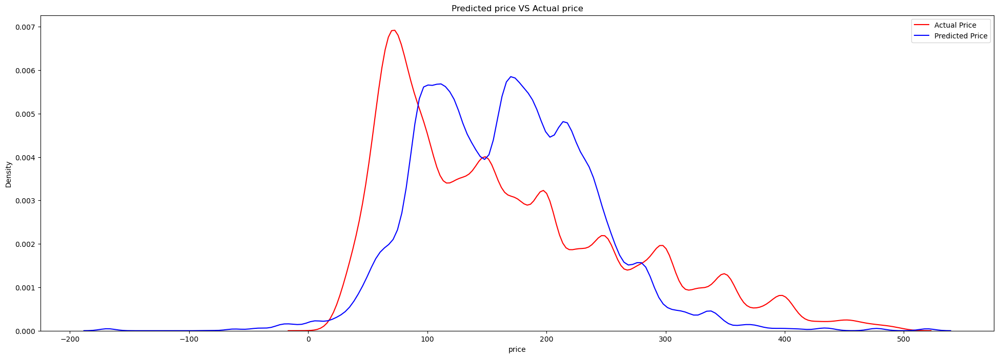

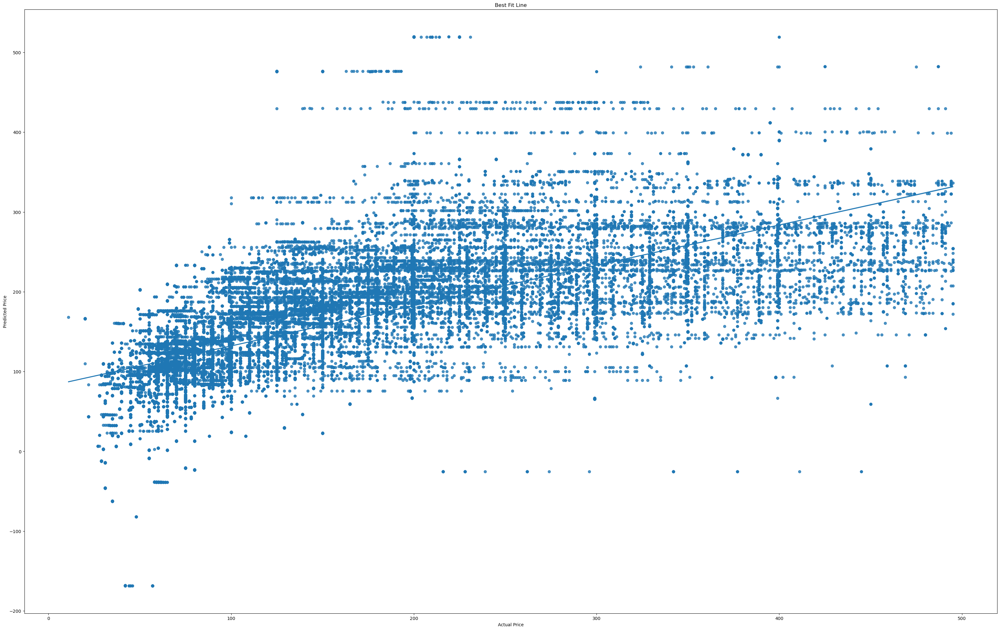

In [61]:
start = time()
lasso_params = {
    "alpha":truncnorm(a=0, b=1000, loc=0.25, scale=0.1),
}
lasso = Lasso()
RandomSearch = RandomizedSearchCV(lasso, lasso_params, n_jobs=-1)
RandomSearch.fit(X_train_reduced, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
lasso = Lasso(**RandomSearch.best_params_)
lasso.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(lasso, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
plt.legend()
ax1.set_title("Predicted price VS Actual price")
plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["pca_lasso"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Ridge regression with reduced data

0.5096699170971261
{'alpha': 0.5260404187767608}
Train R-squared: 0.50969	Train RMSE: $69.54165        
Test R-squared: 0.51000	Test RMSE: $69.71794
Time used =  0.7131938934326172


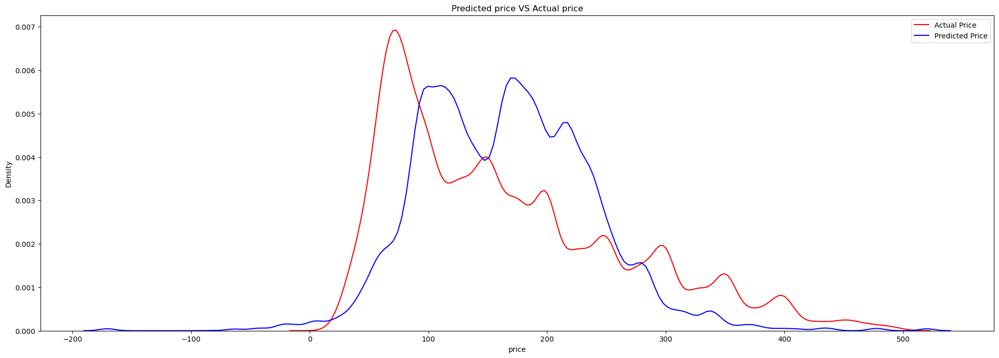

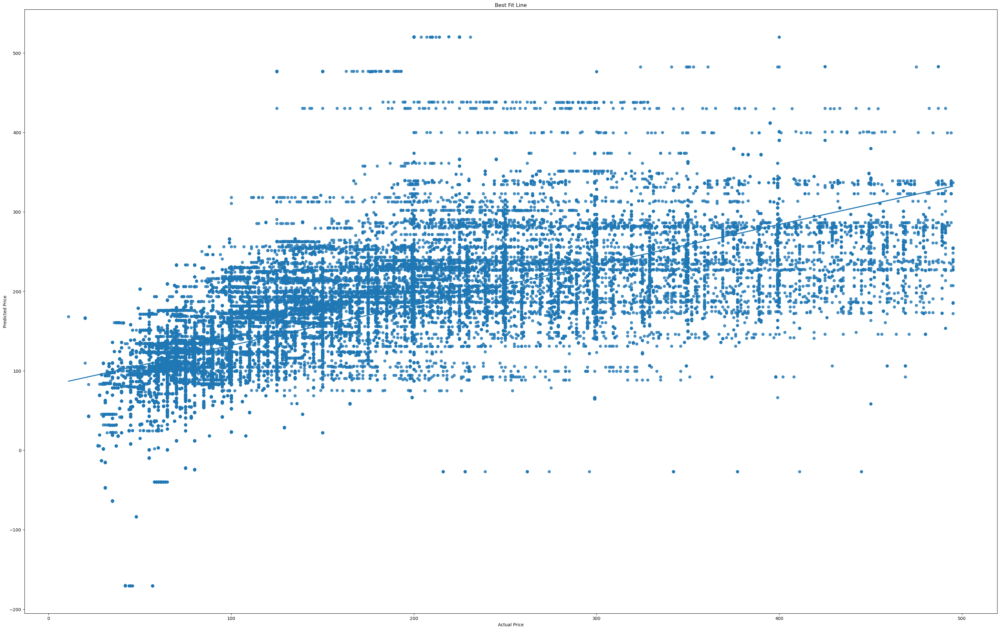

In [62]:
start = time()
ridge_params = {
    "alpha":truncnorm(a=0, b=1000, loc=0.25, scale=0.1),
}
ridge = Ridge()
RandomSearch = RandomizedSearchCV(ridge, ridge_params, n_jobs=-1)
RandomSearch.fit(X_train_reduced, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
ridge = Ridge(**RandomSearch.best_params_)
ridge.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(ridge, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["pca_ridge"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Elastic Net regression with reduced data

0.5095100571519057
{'alpha': 0.365519374311986, 'l1_ratio': 0.9461176224966824}
Train R-squared: 0.50953	Train RMSE: $69.55300        
Test R-squared: 0.50977	Test RMSE: $69.73433
Time used =  0.7206301689147949


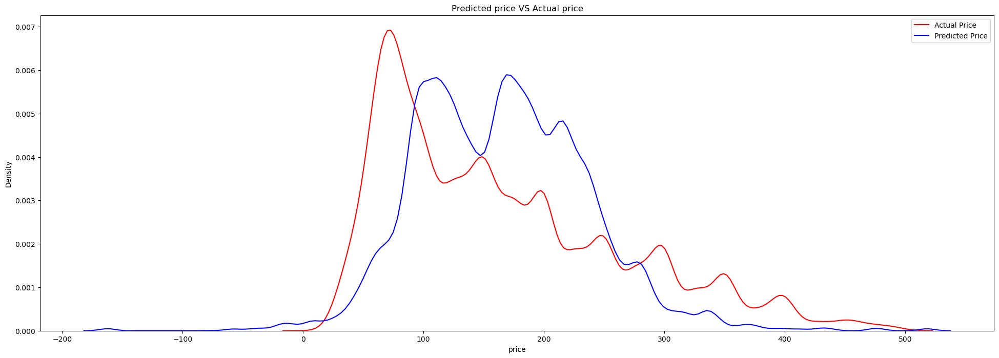

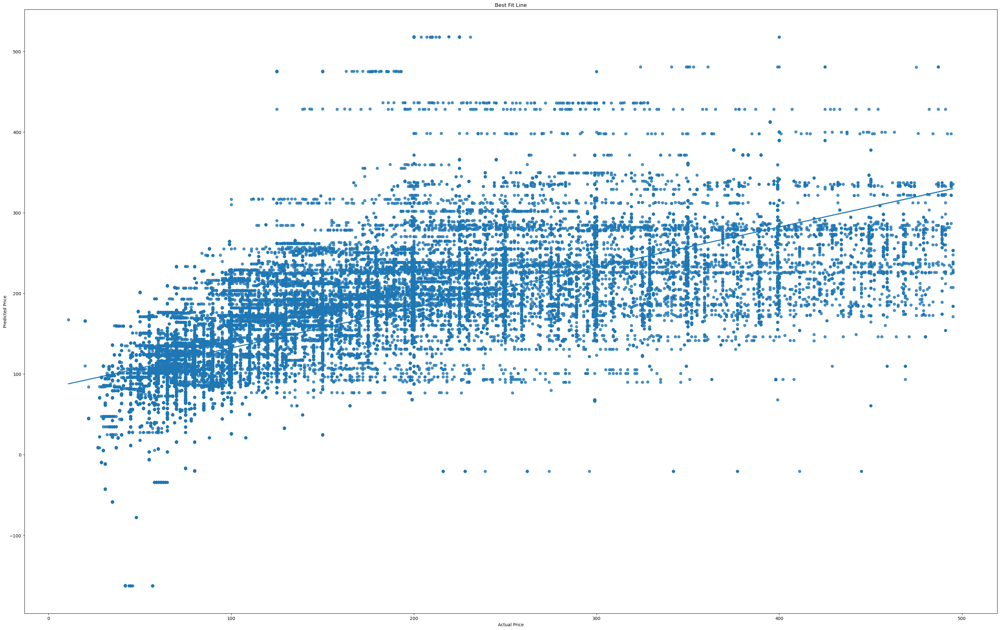

In [63]:
start = time()
EN_params = {
    "alpha":truncnorm(a=0, b=1000, loc=0.25, scale=0.1),
    "l1_ratio":uniform(0, 1)
}
EN = ElasticNet()
RandomSearch = RandomizedSearchCV(EN, EN_params, n_jobs=-1)
RandomSearch.fit(X_train_reduced, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
EN = ElasticNet(**RandomSearch.best_params_)
EN.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(EN, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()
plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["pca_EN"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## KNN regressor with reduced data
- Try KNN regressor with and without standardized data since it may affect the result of KNN which sensitive to the scale of data

0.9739223872241685
{'n_neighbors': 30, 'weights': 'distance'}
Train R-squared: 0.97770	Train RMSE: $14.83175        
Test R-squared: 0.97480	Test RMSE: $15.81113
Time used =  10.349455118179321


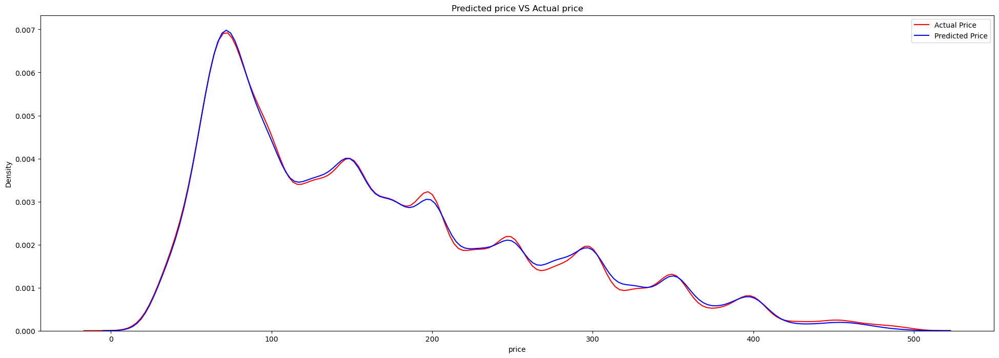

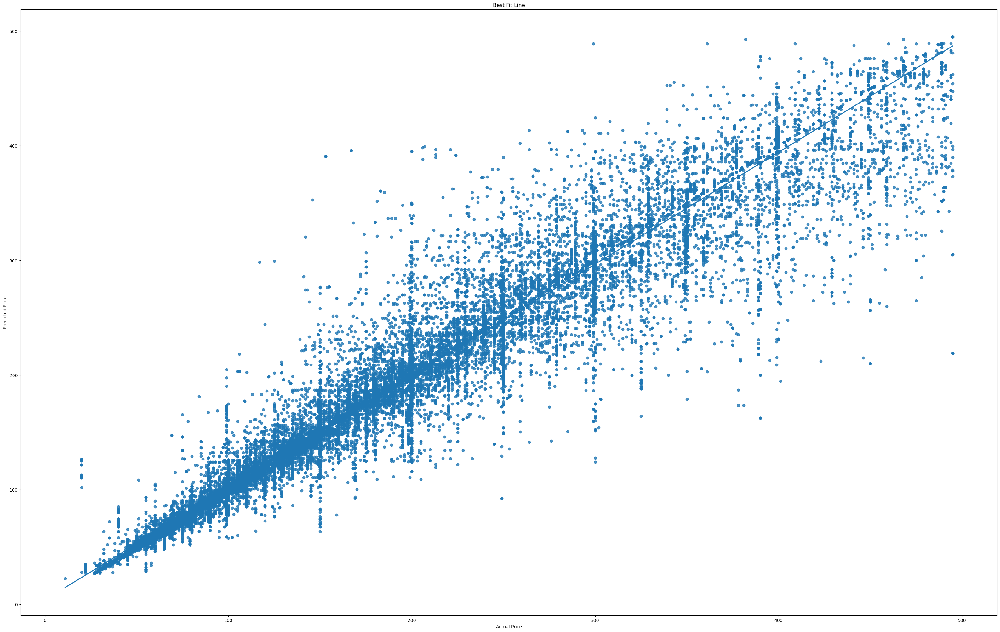

0.9739217059341382
{'n_neighbors': 26, 'weights': 'distance'}
Train R-squared: 0.97770	Train RMSE: $14.83201        
Test R-squared: 0.97480	Test RMSE: $15.81193
Time used =  9.982768774032593


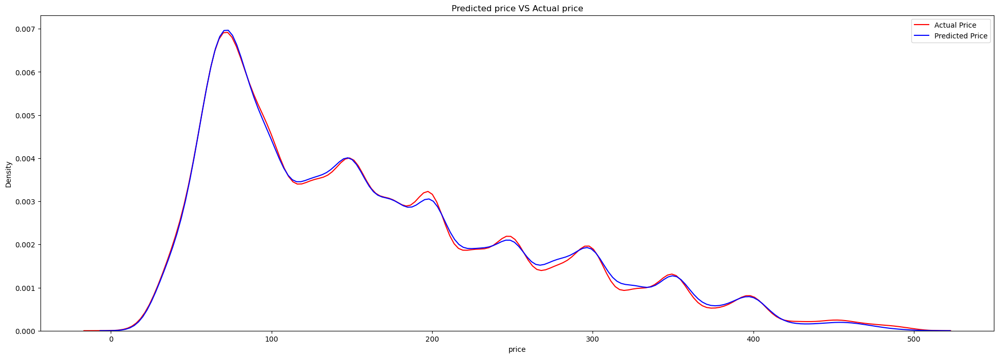

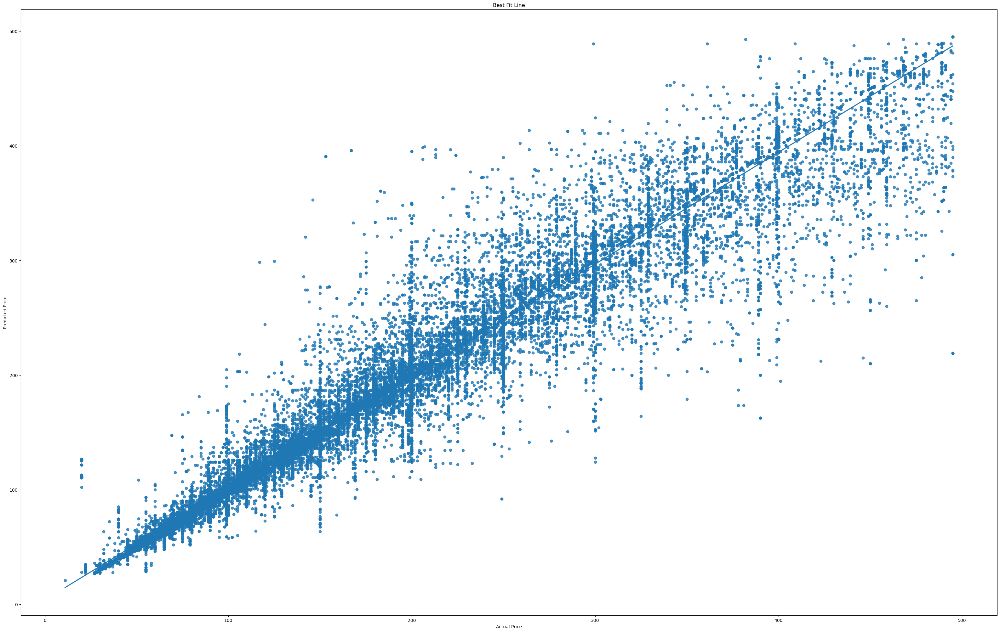

In [64]:
from sklearn.neighbors import KNeighborsRegressor

start = time()
knn_params = {
    "n_neighbors" : [5, 10, 15, 20, 25, 30],
    "weights" : ["uniform", "distance"]
}
knn = KNeighborsRegressor()
GridSearch = GridSearchCV(knn, knn_params, n_jobs=-1)
GridSearch.fit(X_train_reduced, y_train)
print(GridSearch.best_score_)
print(GridSearch.best_params_)
knn = KNeighborsRegressor(**GridSearch.best_params_)
knn.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(knn, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["gridsearch_knn"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

start = time()
knn_params = {
    "n_neighbors" : randint(1, 50),
    "weights" : ["uniform", "distance"]
}
knn = KNeighborsRegressor()
RandomSearch = RandomizedSearchCV(knn, knn_params, n_jobs=-1)
RandomSearch.fit(X_train_reduced, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
knn = KNeighborsRegressor(**RandomSearch.best_params_)
knn.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(knn, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["randomsearch_knn"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Decision Tree Regressor with reduced data

0.9737420829832331
{'max_depth': 1000, 'min_samples_split': 10}
Train R-squared: 0.97766	Train RMSE: $14.84281        
Test R-squared: 0.97457	Test RMSE: $15.88182
Time used =  8.720848798751831



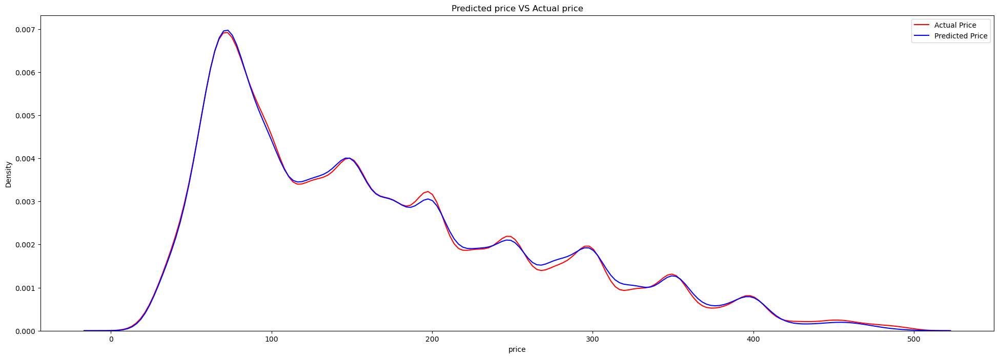

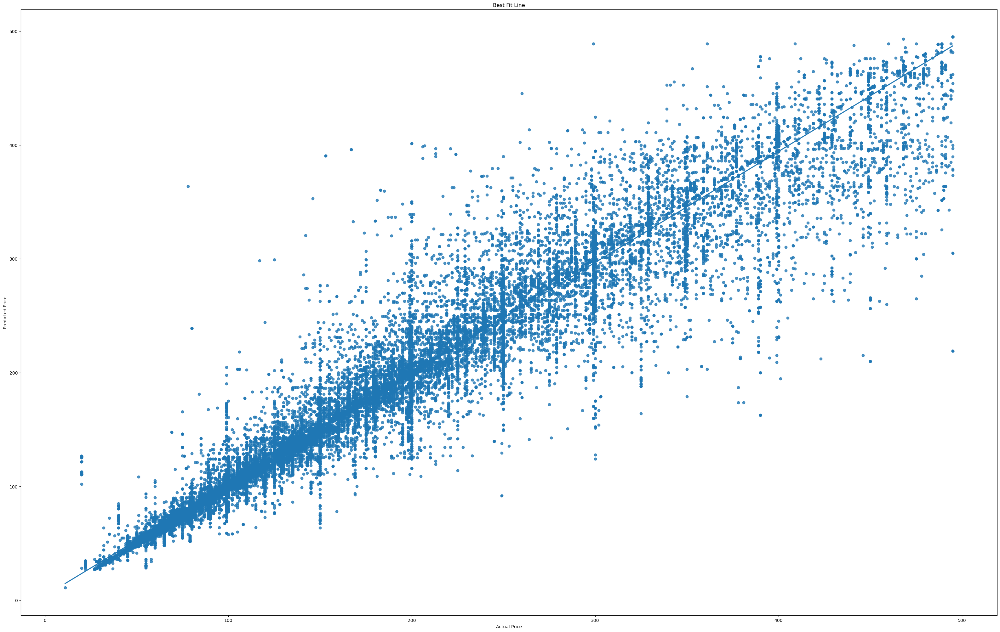

0.9737657589735716
{'max_depth': 693, 'min_samples_split': 3}
Train R-squared: 0.97770	Train RMSE: $14.83194        
Test R-squared: 0.97463	Test RMSE: $15.86514
Time used =  8.208016872406006



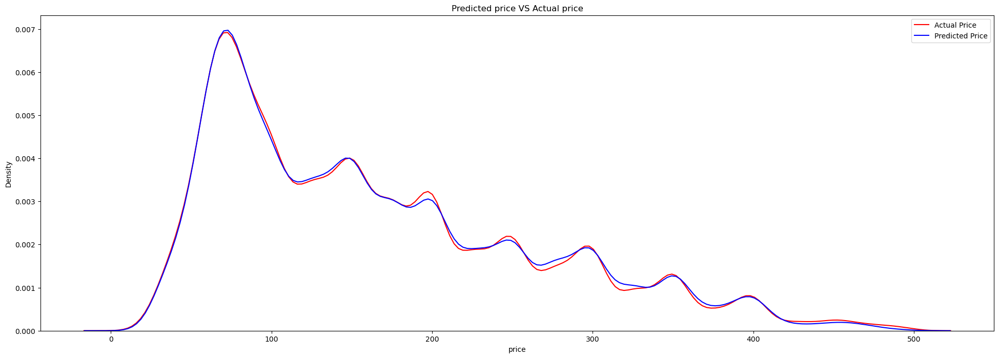

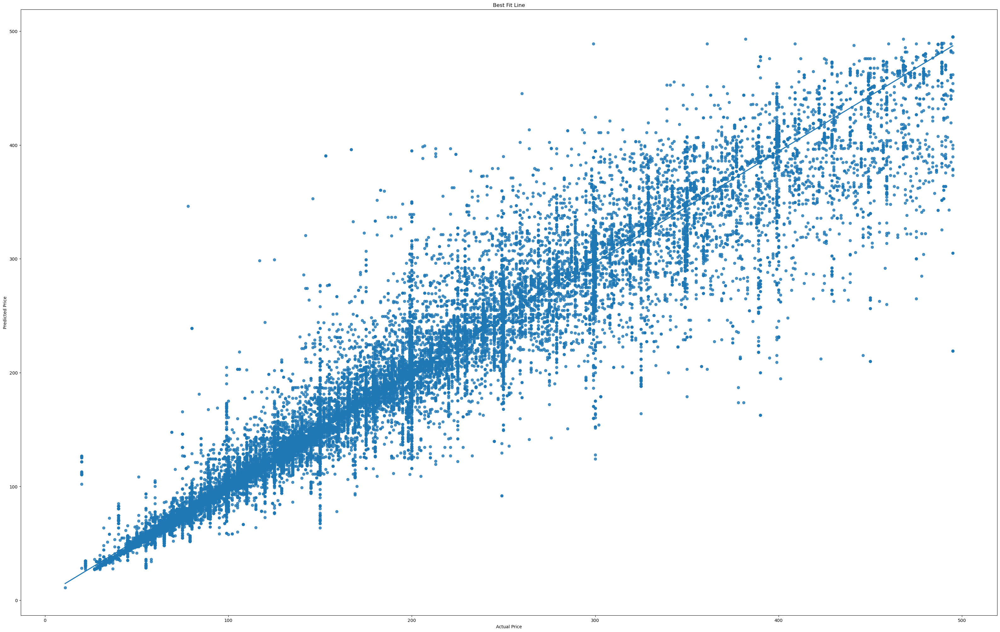

In [65]:
start = time()
tree_params = {
    "max_depth":[10, 100, 1000,], 
    "min_samples_split":[10, 50, 100, 1000]
    }
dtr = DecisionTreeRegressor()
GridSearch = GridSearchCV(dtr, tree_params, n_jobs=-1)
GridSearch.fit(X_train_reduced, y_train)
print(GridSearch.best_score_)
print(GridSearch.best_params_)
dtr = DecisionTreeRegressor(**GridSearch.best_params_)
dtr.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(dtr, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)
print()

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["gridsearch_pca_dtr"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

start = time()
tree_params = {
    "max_depth":randint(1, 1000), 
    "min_samples_split":randint(1, 1000)
    }
dtr = DecisionTreeRegressor()
RandomSearch = RandomizedSearchCV(dtr, tree_params, n_jobs=-1)
RandomSearch.fit(X_train_reduced, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
dtr = DecisionTreeRegressor(**RandomSearch.best_params_)
dtr.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(dtr, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)
print()

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["randomsearch_pca_dtr"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Random forest regressor with reduced data

0.9738774007147157
{'n_estimators': 50}
Train R-squared: 0.97763	Train RMSE: $14.85476        
Test R-squared: 0.97471	Test RMSE: $15.83938
Time used =  108.58796215057373


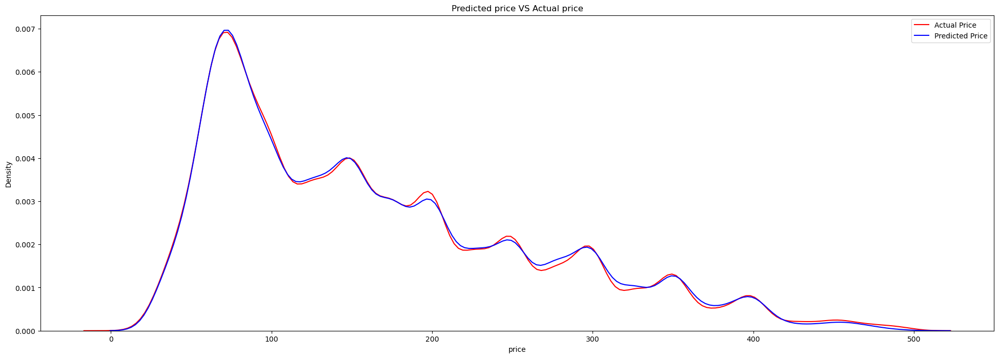

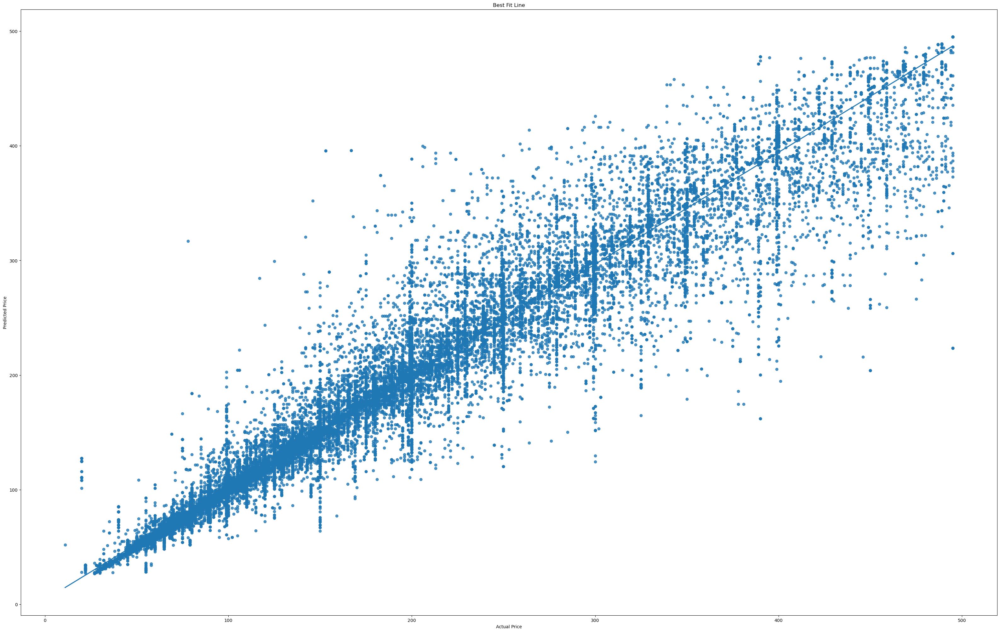

0.9738839855923022
{'n_estimators': 46}
Train R-squared: 0.97763	Train RMSE: $14.85460        
Test R-squared: 0.97472	Test RMSE: $15.83712
Time used =  216.85600209236145


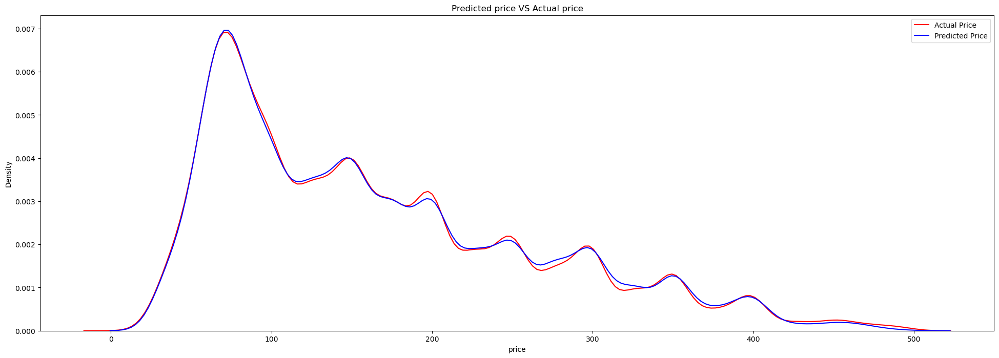

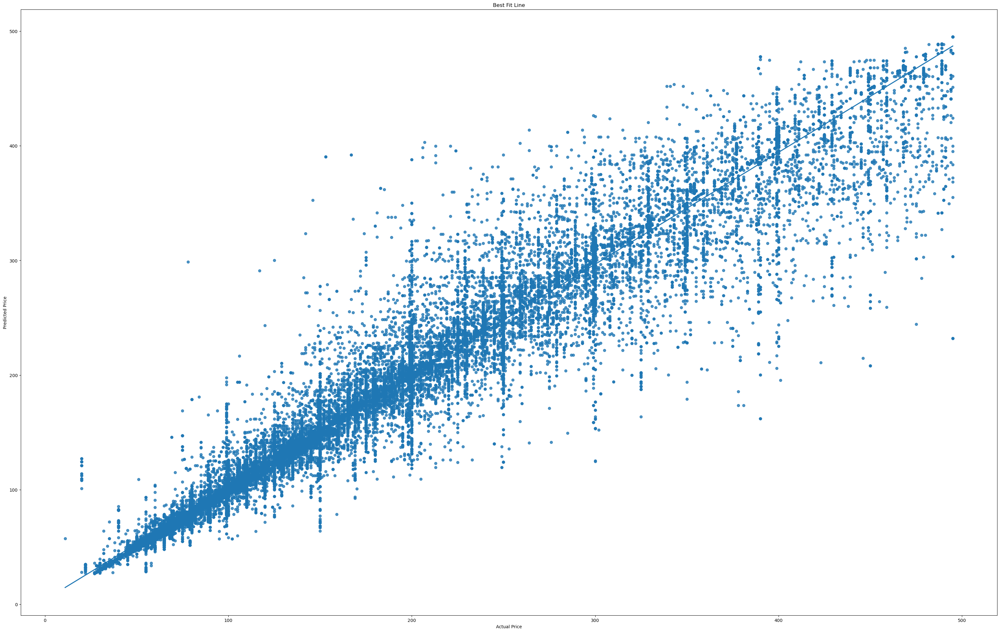

In [66]:
start = time()
forest_params = {
    'n_estimators':[30, 40, 50],
}
rf = RandomForestRegressor()
GridSearch = GridSearchCV(rf, forest_params, n_jobs=-1)
GridSearch.fit(X_train_reduced, y_train)
print(GridSearch.best_score_)
print(GridSearch.best_params_)
rf = RandomForestRegressor(**GridSearch.best_params_)
rf.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(rf, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["gridsearch_pca_rf"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

start = time()
forest_params = {
    'n_estimators':randint(21, 50)
    }
rf = RandomForestRegressor()
RandomSearch = RandomizedSearchCV(rf, forest_params, n_jobs=-1)
RandomSearch.fit(X_train_reduced, y_train)
print(RandomSearch.best_score_)
print(RandomSearch.best_params_)
rf = RandomForestRegressor(**RandomSearch.best_params_)
rf.fit(X_train_reduced, y_train)
r2train, r2test, rmse_train, rmse_test, y_pred = scores(rf, X_train_reduced, y_train, X_test_reduced, y_test)
end = time()
print("Time used = ", end - start)

fig = plt.figure(figsize=(24, 8))
ax1 = sns.kdeplot(data=y_test, color="r", label="Actual Price")
ax2 = sns.kdeplot(data=y_pred, color="b", label="Predicted Price")
ax1.set_title("Predicted price VS Actual price")
plt.legend()

plt.show()

fig = plt.figure(figsize=(40, 25))
ax3 = sns.regplot(x=y_test, y=y_pred)
plt.title("Best Fit Line")
ax3.set_xlabel("Actual Price")
ax3.set_ylabel("Predicted Price")
plt.show()

model_scores["randomsearch_pca_rf"]=[r2train, r2test, rmse_train, rmse_test]
time_used.append(end - start)

## Comparison between all the models

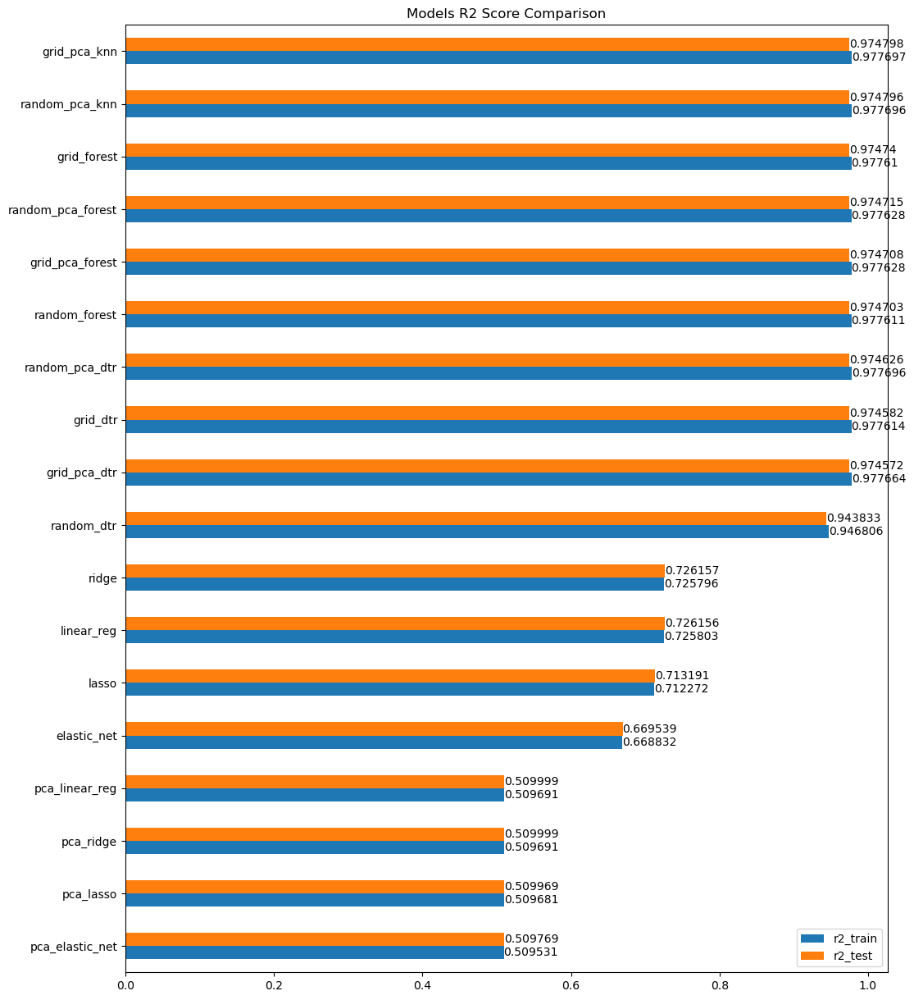

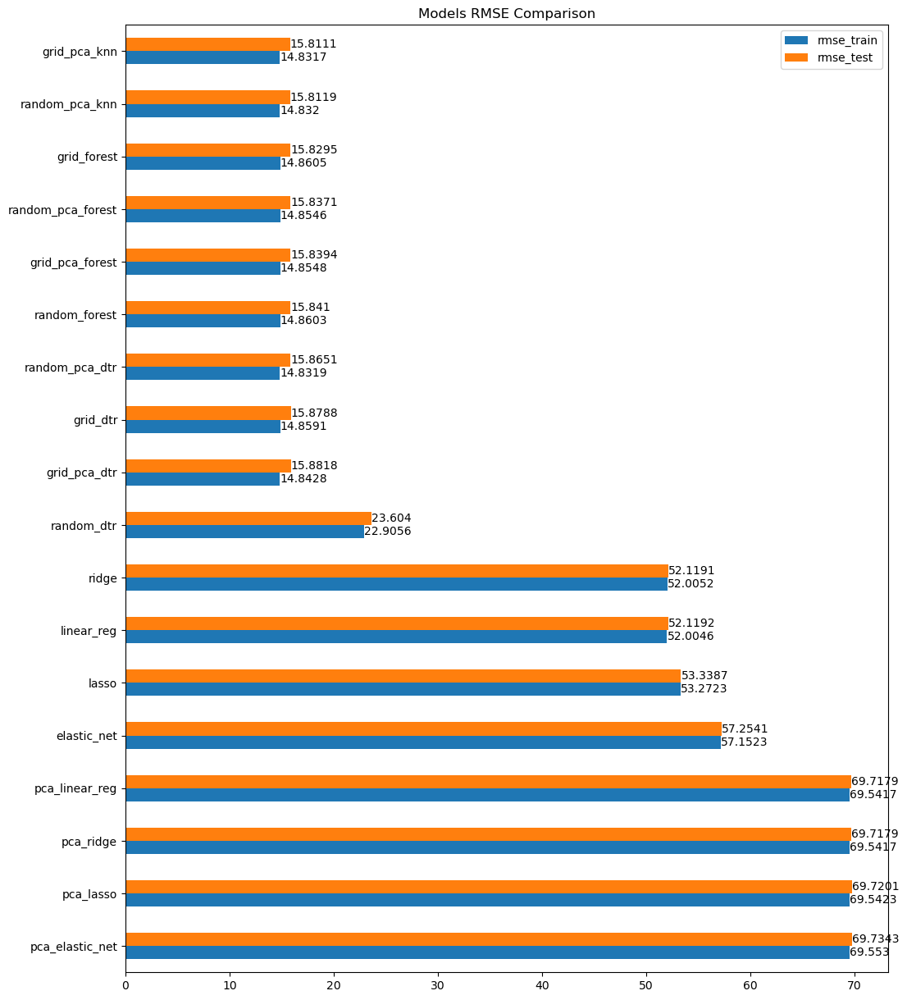

In [67]:
r2train, r2test, rmse_train, rmse_test = [], [], [], []
for key in list(model_scores.keys()):
    r2train.append(model_scores[key][0])
    r2test.append(model_scores[key][1])    
    rmse_train.append(model_scores[key][2])    
    rmse_test.append(model_scores[key][3])

model = [
    "linear_reg", "lasso", "ridge", "elastic_net",
    "grid_dtr", "random_dtr", "grid_forest", "random_forest",
    "pca_linear_reg", "pca_lasso", "pca_ridge", "pca_elastic_net",
    "grid_pca_knn", "random_pca_knn", "grid_pca_dtr", "random_pca_dtr",
    "grid_pca_forest", "random_pca_forest"
]    

r2 = pd.DataFrame({"r2_train":r2train, "r2_test":r2test}, index=model).sort_values("r2_test")
ax = r2.plot.barh(title="Models R2 Score Comparison", figsize=(12, 15))
ax.bar_label(ax.containers[0])
ax.bar_label(ax.containers[1])
plt.show()

rmse = pd.DataFrame({"rmse_train":rmse_train, "rmse_test":rmse_test}, index=model).sort_values("rmse_test", ascending=False)
ax = rmse.plot.barh(title="Models RMSE Comparison", figsize=(12, 15))
ax.bar_label(ax.containers[0])
ax.bar_label(ax.containers[1])
plt.show()



Models R² Score Comparison
- R² Score: Reflects the proportion of the variance for the dependent variable that's explained by the independent variables in the model. An R² score of 1 indicates that the regression predictions perfectly fit the data.
- In the first image, we see that models prefixed with grid_pca_, random_pca_, and grid_ generally have high R² scores, indicating a good fit. The grid_pca_knn model has the highest R² score on both training and test datasets.
- The difference between the blue and orange bars represents the difference in performance on the training set versus the test set. Smaller differences indicate that the model generalizes well.

Models RMSE Comparison
- RMSE Score: Provides a measure of how accurately the model predicts the response, and is the most common measure of the average error made by the model. Lower RMSE values indicate a better fit.
- In the second image, most models have similar RMSE scores, with grid_pca_knn, random_pca_knn, and grid_forest showing the lowest RMSE, indicating better predictive accuracy.
- The models at the bottom of the graph (pca_linear_reg, pca_ridge, pca_lasso, pca_elastic_net) have significantly higher RMSE scores, indicating that they are less accurate in their predictions.
- Again, the difference between the blue and orange bars shows the difference in performance on the training set versus the test set. Models with smaller differences are more robust to overfitting.


## Compare the time used for each model ordered by R2-Score

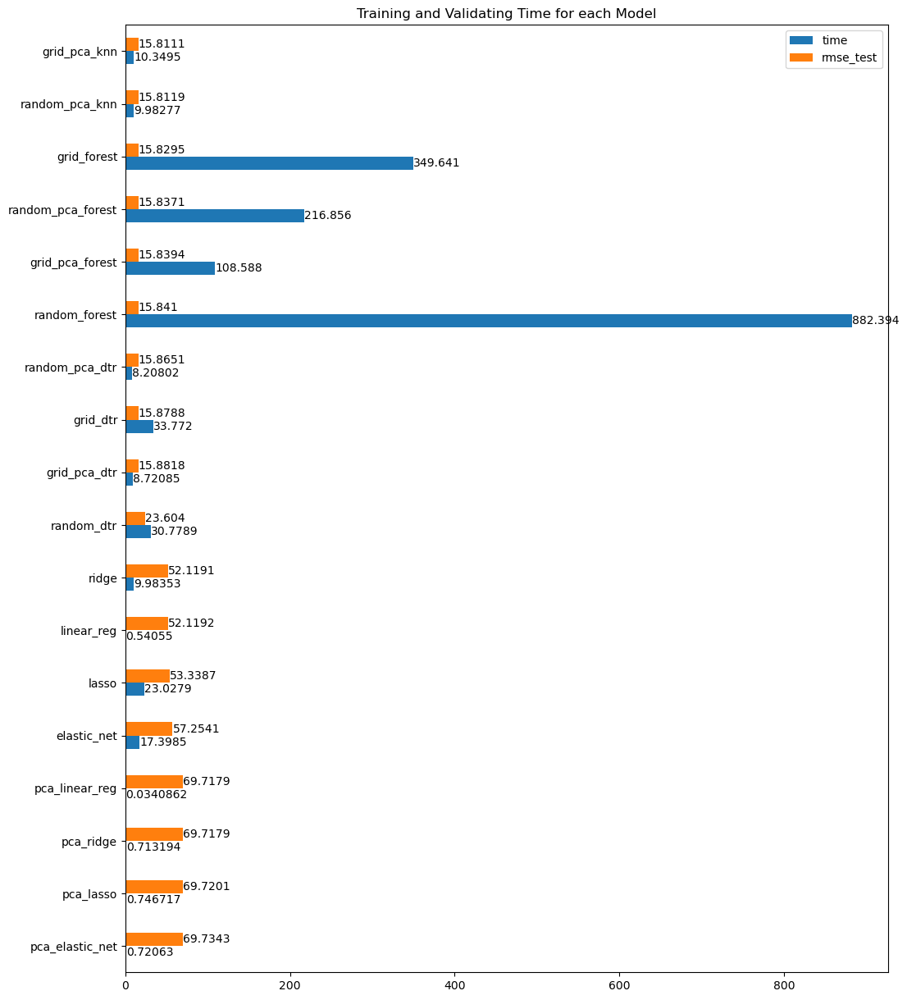

In [68]:
time_elapsed = pd.DataFrame({"time":time_used, "rmse_test":rmse_test}, index=model).sort_values("rmse_test", ascending=False)
ax = time_elapsed.plot.barh(title="Training and Validating Time for each Model", figsize=(12, 15))
ax.bar_label(ax.containers[0])
ax.bar_label(ax.containers[1])
plt.show()

Here are some insights from the graph:

- Model Efficiency: The grid_forest model takes the longest time to train and validate, as indicated by its longest blue bar. However, it does not have the lowest RMSE, suggesting that while it may be thorough, it is not the most time-efficient model.
- Model Performance: The random_forest model has a high RMSE compared to others, but it also takes a significantly longer time to train and validate, shown by a long blue bar. This might indicate that the model is complex and may be overfitting.
- Quick Models: The ridge and linear_reg models show relatively quick training and validation times with moderate RMSE scores. These models may offer a good balance between time efficiency and prediction accuracy.
- PCA Models: Models that use PCA (pca_linear_reg, pca_ridge, pca_lasso, pca_elastic_net) have the shortest training and validation times, which is typical for PCA-reduced datasets since they have fewer dimensions to process. However, they also have the highest RMSE scores, suggesting that the dimensionality reduction might have removed some important predictive information.

## Visualize the top 15 features based on importance from the result of DTR and RF

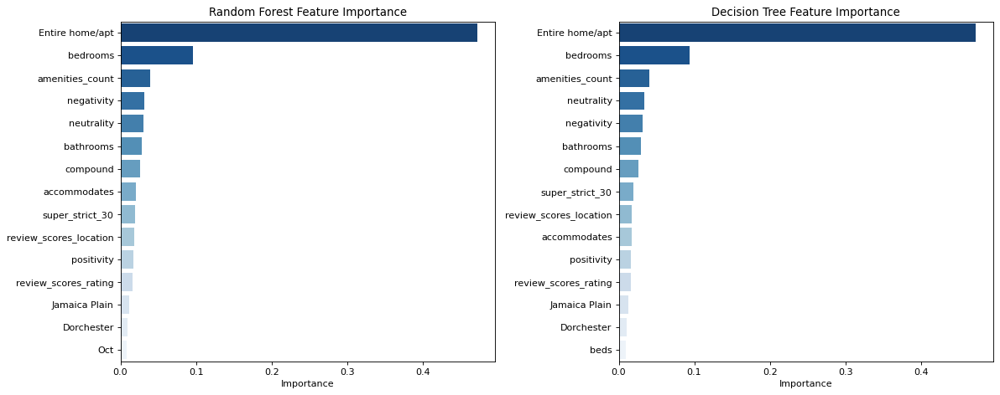

In [69]:
def filter_coefficients(keyword, coefficients_df):
    """
    Filters a dataframe of coefficients for specific features
    
    Parameters:
        keyword (str): The keyword to filter the features by
        coefficients_df (DataFrame): the coefficients df to filter by
    
    Returns:
        df (DataFrame): a keyword filtered dataframe of coefficients
    """
    
    df = coefficients_df[coefficients_df.\
                         features.str.contains(keyword)].copy()
    df.features = df.features.str.lstrip(keyword+'_')
    
    return df

def plot_coefficients(coefficients_df, ax=None, palette='icefire', xlabel='Coefficients', title=None):
    """Plots a horizontal barplot of the coefficients"""
    
    sns.barplot(
        y='features', x='coefficients',
        orient='h', data=coefficients_df,
        palette=palette,
        ax = ax
    )
    if ax:
        ax.set_xlabel(xlabel)
        ax.set_ylabel('')
        ax.set_title(title)
    else:
        plt.xlabel(xlabel)
        plt.ylabel('')
        plt.title(title)

def get_feature_importances(model):
    """Return sorted model feature importances"""
    
    df = pd.DataFrame(
        {'features': X.columns, 'coefficients': model.feature_importances_}
    ).sort_values(by='coefficients', ascending=False)[:15]
    return df
        
rf = RandomForestRegressor(n_estimators=46)
rf.fit(X_train, y_train)
dtr = DecisionTreeRegressor(max_depth=100, min_samples_split=10)
dtr.fit(X_train, y_train)
fig, axs = plt.subplots(1, 2, figsize=(15, 6), dpi=80)
plot_coefficients(
    get_feature_importances(rf), ax=axs[0], xlabel='Importance',
    title='Random Forest Feature Importance', palette='Blues_r')
plot_coefficients(
    get_feature_importances(dtr), ax=axs[1], xlabel='Importance',
    title='Decision Tree Feature Importance', palette='Blues_r')

plt.tight_layout()
plt.show()

Here's an interpretation of the two visualizations:

- Entire home/apt: This feature has the highest importance in both models, which suggests that whether a listing is for the entire home or apartment is a significant predictor for the model's outcome (likely the price or some performance metric of the listings).
- bedrooms and bedrooms: These features also have high importance in both models, indicating they are strong predictors as well. It is common for the number of bedrooms and beds to be closely related to the value of a listing.
- amenities_count: This feature appears to be relatively important, which makes sense as more amenities could increase a listing's attractiveness and possibly its price.
- Sentiment-related features: Features like negativity, neutrality, compound, and positivity are derived from sentiment analysis and appear to have moderate importance. This indicates that the sentiment in the listing's reviews has a significant impact on the model's predictions.
- accommodates: This feature is also among the top features, suggesting that the capacity of a listing is a key predictor.
- review_scores_location: This feature's importance suggests that the location score of a review can significantly impact the model's outcome.
- Cancellation Policy: The feature super_strict_30 is also a key predictor, possibly reflecting the correlation between cancellation policy strictness and the listing's value.

The fact that the top features are similar for both models suggests these features are robust predictors across different model types. The presence of features like Dorchester and Jamaica Plain indicates that specific locations or neighborhoods may also have a significant impact on the model's predictions, possibly due to their respective desirability or market prices.

In both models, the feature importances are less than 0.5, which indicates that the prediction is influenced by a combination of features rather than being dominated by a single feature. This is typical in complex datasets where multiple factors influence the outcome.

# Discussions :
- At first, we train the models without remove the outliers, although the R2-score of decision tree model is quite good, around 0.90 to 0.92, the score for linear model is extremely low, around 0.45 to 0.6. After we remove all the outliers, R2-score of decision tree becomes around 0.94 to 0.98 while linear models become 0.65 to 0.72, which is a big improvement
- We train the original data with linear model and decision tree regressor and found that the decision tree regressor is more suitable to solve this problem
    - The performance(from good to bad) in descending order is decision tree followed by linear regression or ridge regression, lasso regression and the worst elastic net
    - We did not try with knn regressor because it is very time consuming
- We train the reduced data which left with 4 dimensions only with linear model, decision tree regressor and knn regressor and both knn regressor and decision tree regressor perform quite well
    - The performance in descending order(from good to bad) is decision tree or knn, followed by linear regression or ridge regression, lasso regression and the worst elastic net
    - The drop in performance of linear models may caused by the number of features=4 is too small
- The performance of Decision Tree Regressor is similar to the Random Forest Regressor but the time used for random forest regressor is very long compared to decision tree
- We can't compare random forest regressor with linear model since random forest is much complex model but we can compare decision tree with linear regression and knn model
- The performances of each model are in our expectation since this problem is basically just a if-else problem(decision tree) and "find the similarities"(knn) based on our experiences in real life
- In conclusion, our best model(random forest or knn or decision tree) trained can help the host to decide the suitable price for their listings with root mean squared error of $16 which is considered very good